# Supervised Segmentation Approaches

<h1>Supervised Segmentation Approaches</h1>
<br />
<p>
<b>Quantitative Big Imaging</b> ETHZ: 227-0966-00L
<br />
<b>Part 2</b>  
</p>
<p style="font-size:1em;">March 23, 2023</p>
<br /><br />
<p style="font-size:1.5em;padding-bottom: 0.25em;">Anders Kaestner</p>  
<p style="font-size:1em;">Laboratory for Neutron Scattering and Imaging<br />Paul Scherrer Institut</p>

## Overview
1. Methods
1. Pipelines
2. Classification
3. Regression
4. Segmentation

## Reading Material

- [Introduction to Machine Learning: ETH Course](https://las.inf.ethz.ch/teaching/introml-s18)
- [Decision Forests for Computer Vision and Medical Image Analysis](https://www.amazon.com/Decision-Computer-Analysis-Advances-Recognition/dp/1447149289/ref=sr_1_1?s=books&ie=UTF8&qid=1521704598&sr=1-1&refinements=p_27%3AAntonio+Criminisi&dpID=41fMCWUOh%252BL&preST=_SY291_BO1,204,203,200_QL40_&dpSrc=srch)
- [U-Net: Convolutional Networks for Biomedical Image Segmentation](https://arxiv.org/abs/1505.04597)
- [U-Net Website](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/)

### Load some modules for the notebook

In [1]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from skimage.io        import imread
from sklearn.datasets  import make_blobs
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble  import RandomForestClassifier
from sklearn.tree      import export_graphviz
import graphviz
from sklearn.tree      import DecisionTreeClassifier
from sklearn.tree      import DecisionTreeRegressor
from sklearn.ensemble  import RandomForestRegressor
#from pipe_utils        import px_flatten_step, show_pipe, fit_img_pipe
from sklearn.pipeline  import Pipeline
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import FunctionTransformer
from sklearn.cluster   import KMeans

%matplotlib inline

plt.rcParams['font.family'] = ['sans-serif']
plt.rcParams['font.sans-serif'] = ['DejaVu Sans']
plt.style.use('ggplot')
sns.set_style("whitegrid", {'axes.grid': False})

# Basic Methods Overview
There are a number of supervised methods we can use for 
 - classification, 
 - regression 
 - and both. 

There are a number of methods we can use for classification, regression and both. For the simplification of the material we will not make a massive distinction between classification and regression but there are many situations where this is not appropriate. Here we cover a few basic methods, since these are important to understand as a starting point for solving difficult problems. The list is not complete and importantly Support Vector Machines are completely missing which can be a very useful tool in supervised analysis.
A core idea to supervised models is they have a training phase and a predicting phase. 

## Training

The training phase is when the parameters of the model are *learned* and involve putting inputs into the model and updating the parameters so they better match the outputs. This is a sort-of curve fitting (with linear regression it is exactly curve fitting).

- The training phase is when the parameters of the model are *learned* 
- Used training data with ground truth.

## Predicting

The predicting phase is once the parameters have been set applying the model to new datasets. At this point the parameters are no longer adjusted or updated and the model is frozen. Generally it is not possible to tweak a model any more using new data but some approaches (most notably neural networks) are able to handle this. 

- Provides responses on inputs using the trained model.
- Uses new unseen data.

# Classification

## Lets create some data...
Here we create some bivariate data 'blobs' with Gaussian distribution. This time the blobs have classes assigned to them. The table 

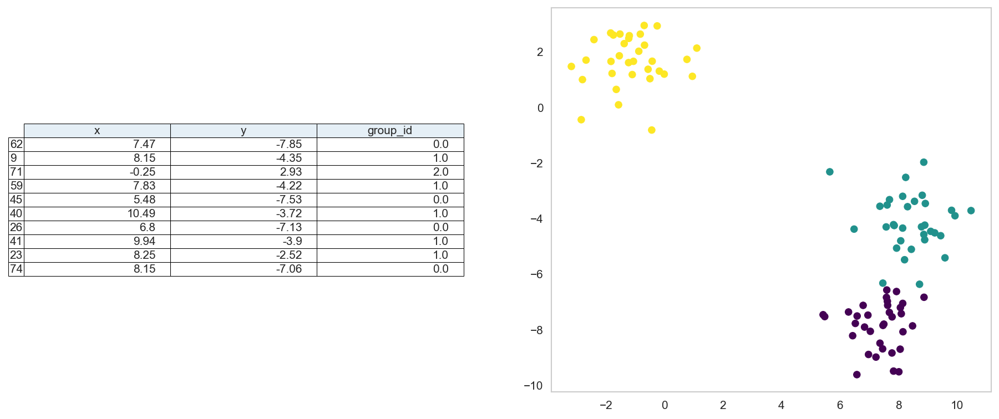

In [2]:
blob_data, blob_labels = make_blobs(n_samples=100,
                                    random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels

fig,ax = plt.subplots(1,2,figsize=(15,6),dpi=150)
ax[1].scatter(test_pts.x, test_pts.y,
            c=test_pts.group_id,
            cmap='viridis')
ccolors = plt.cm.BuPu(np.full(3, 0.1))
pd.plotting.table(data=test_pts.sample(10).round(decimals=2), ax=ax[0], loc='center',colColours=ccolors)
ax[0].axis('off');

## Nearest Neighbor (or K Nearest Neighbors)
The technique is as basic as it sounds, it basically finds the nearest point to what you have put in. 

The _k nearest neighbors_ algorithm makes the inference based on a point cloud of training point. When the model is presented with a new point it computes the distance to the closest points in the model. The _k_ in the algorithm name indicates how many neighbors should be considered. E.g. _k=3_ means that the major class of the three nearest neighbors is assigned the tested point. 

Looking at the example below we would say that using three neighbors the 

- Green hiker would claim he is in a spruce forest.
- Orange hiker would claim he is in a mixed forest.
- Blue hiker would claim he is in a birch forest.

```{figure} figures/forest.pdf
---
scale: 100%
---
Depending on the where the hiker is standing he makes the the conclusion that is either in a birch or spruce forest.
```

<figure><img src="figures/forest.svg" style="height:500px"></figure>

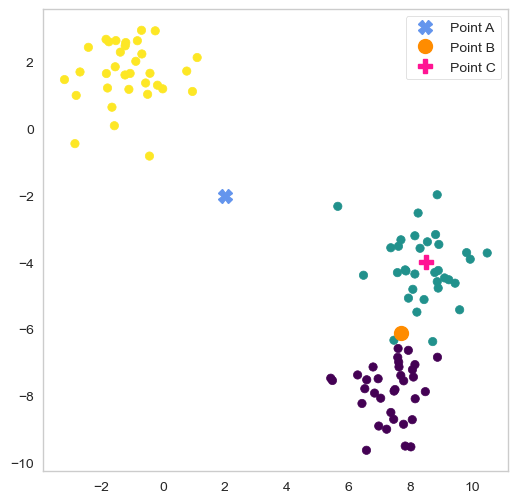

In [3]:
plt.figure(figsize=[6,6],dpi=100)
plt.scatter(test_pts.x, test_pts.y,
            c=test_pts.group_id,
            cmap='viridis')
plt.plot(2,-2,'X',color='cornflowerblue',markersize=10,label='Point A')
plt.plot(7.7,-6.1,'o',color='darkorange',markersize=10,label='Point B')
plt.plot(8.5,-4,'P',color='deeppink',markersize=10,label='Point C')
plt.legend();

## Text example
__Training data__

| Value | 1   | 2   | 3   | 4   |
|-------|-----|-----|-----|-----|
| Class | I   | am  | a   | dog |

__Start the training__

In [4]:
from sklearn.neighbors import KNeighborsClassifier
import numpy as np
k_class = KNeighborsClassifier(1)
k_class.fit(X=np.reshape([0, 1, 2, 3], (-1, 1)),
            y=['I', 'am', 'a', 'dog'])

KNeighborsClassifier(n_neighbors=1)

## Nearest neighbor predictions
### Basic test
Same values as training

In [5]:
print(k_class.predict(np.reshape([0, 1, 2, 3],
                                 (-1, 1))))

['I' 'am' 'a' 'dog']


### Testing with different values

In [6]:
print("Input  :",k_class.predict(np.reshape([1.5], (1, 1))))
print("Input 100 :",k_class.predict(np.reshape([100], (1, 1))))

Input  : ['am']
Input 100 : ['dog']


## Let's come back to the blob data

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
%matplotlib inline

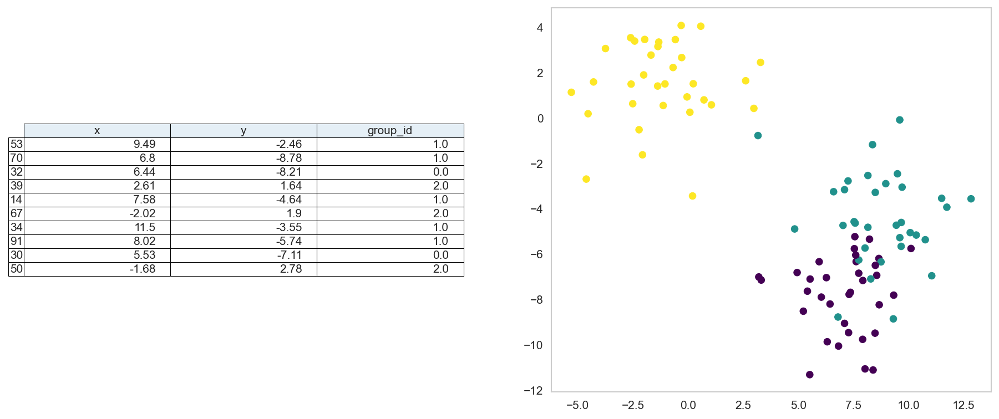

In [8]:
blob_data, blob_labels = make_blobs(n_samples=100,
                                    cluster_std=2.0,
                                    random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels

fig, ax = plt.subplots(1,2,figsize=(15,6),dpi=150)
ax[1].scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis')
ccolors = plt.cm.BuPu(np.full(3, 0.1))
pd.plotting.table(data=test_pts.sample(10).round(decimals=2), ax=ax[0], loc='center',colColours=ccolors)
ax[0].axis('off');

## Training the model using one neighbor

In [9]:
# Define classifier
k_class = KNeighborsClassifier(1)

# Train the classifier model with data
k_class.fit(test_pts[['x', 'y']], test_pts['group_id']) 

KNeighborsClassifier(n_neighbors=1)

### Resulting prediction map for a single neighbor

In [12]:
xx, yy = np.meshgrid(np.linspace(test_pts.x.min(), test_pts.x.max(), 30),np.linspace(test_pts.y.min(), test_pts.y.max(), 30),indexing='ij');
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
grid_pts['predicted_id'] = k_class.predict(grid_pts[['x', 'y']])

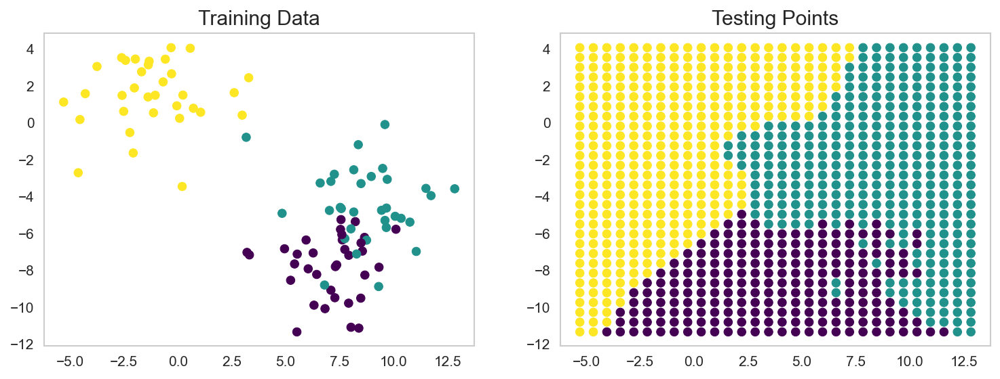

In [13]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4),dpi=150)
ax1.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis'); 
ax1.set_title('Training Data');
ax2.scatter(grid_pts.x, grid_pts.y, c=grid_pts.predicted_id, cmap='viridis'); 
ax2.set_title('Testing Points');

## Stabilizing Results - Increase number of neighbors
- We can see here that the result is thrown off by single points
- Prediction can be improved by using more than the nearest neighbor

In [14]:
k_class = KNeighborsClassifier(n_neighbors=4)
k_class =  k_class.fit(test_pts[['x', 'y']], test_pts['group_id'])
xx, yy = np.meshgrid(np.linspace(test_pts.x.min(), test_pts.x.max(), 30),
                     np.linspace(test_pts.y.min(), test_pts.y.max(), 30),
                     indexing='ij'
                     )
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
grid_pts['predicted_id'] = k_class.predict(grid_pts[['x', 'y']])

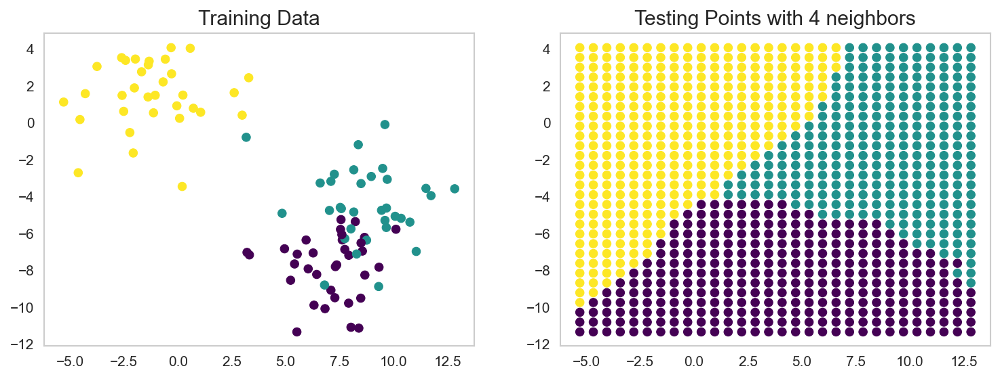

In [15]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4),dpi=150)
ax1.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis'); 
ax1.set_title('Training Data');
ax2.scatter(grid_pts.x, grid_pts.y, c=grid_pts.predicted_id, cmap='viridis');
ax2.set_title('Testing Points with 4 neighbors');

# Linear Regression
- Linear regression is a fancy-name for linear curve fitting
- Fitting a line through points (sometimes in more than one dimension). 
- It is a very basic method, 
    - is easy to understand, 
    - interpret 
    - and fast to compute

## We need data to fit...

slope: 10.0, intercept: 10.0


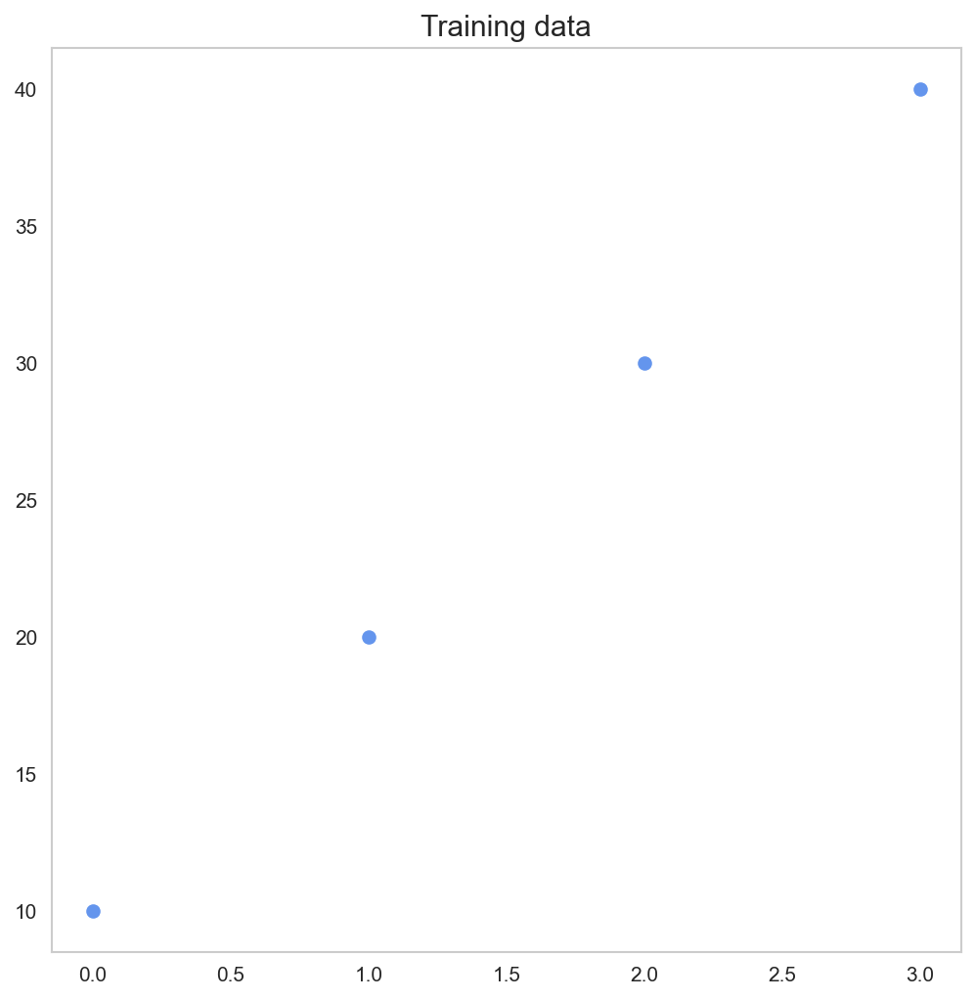

In [16]:
from sklearn.linear_model import LinearRegression

x = np.array([0, 1, 2, 3])
y = np.array([10, 20, 30, 40] )

plt.plot(x,y,'o',color='cornflowerblue'); plt.title('Training data')

l_reg = LinearRegression()
l_reg.fit(X=np.reshape(x, (-1, 1)),y=y)

print("slope: {0:0.4}, intercept: {1:0.4}".format(l_reg.coef_[0], l_reg.intercept_))

### Let's try the model on some data points

In [18]:
print('An array of values:', l_reg.predict(np.reshape([0, 1, 2, 3], (-1, 1))))
print('x:',-100, '=>',       l_reg.predict(np.reshape([-100], (1, 1))))
print('x: ',500, '=>',       l_reg.predict(np.reshape([500], (1, 1))))

An array of values: [10. 20. 30. 40.]
x: -100 => [-990.]
x:  500 => [5010.]


## Regression on blob data

In [19]:
from sklearn.datasets import make_blobs
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd

In [22]:
blob_data, blob_labels = make_blobs(centers=2, n_samples=100,
                                    random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels

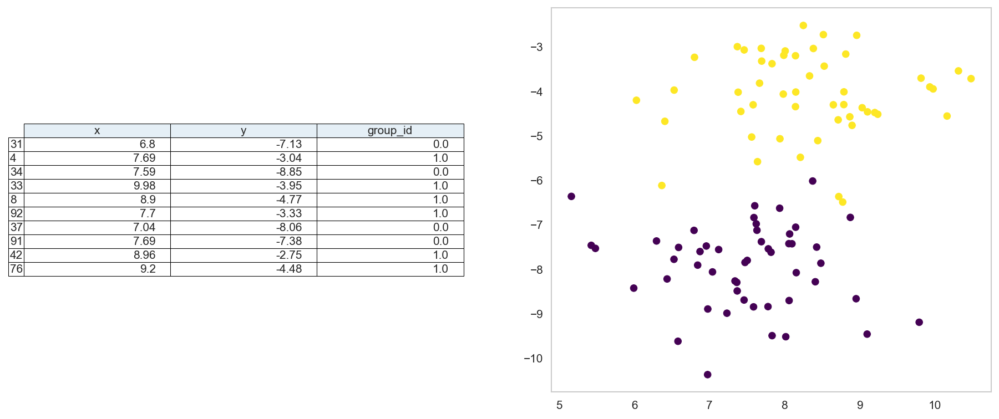

In [23]:
fig, ax = plt.subplots(1,2,figsize=(15,6),dpi=150)
ax[1].scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis')

ccolors = plt.cm.BuPu(np.full(3, 0.1))
pd.plotting.table(data=test_pts.sample(10).round(decimals=2), ax=ax[0], loc='center',colColours=ccolors)
ax[0].axis('off');

## Train the regression model

In [26]:
l_reg = LinearRegression()
l_reg.fit(test_pts[['x', 'y']], test_pts['group_id'])
print('Slope', l_reg.coef_)
print('Offset', l_reg.intercept_)

Slope [0.04813137 0.20391973]
Offset 1.346929708594462


### Evaluate the regression model

In [27]:
xx, yy = np.meshgrid(np.linspace(test_pts.x.min(), test_pts.x.max(), 20),
                     np.linspace(test_pts.y.min(), test_pts.y.max(), 20),
                     indexing='ij'
                     )
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
grid_pts['predicted_id'] = l_reg.predict(grid_pts[['x', 'y']])

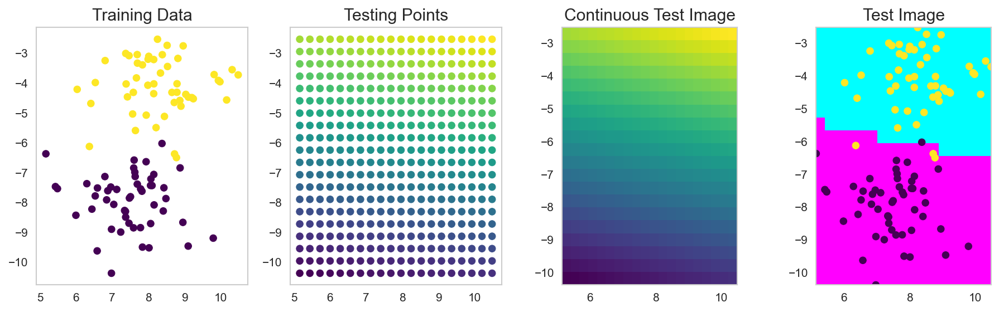

In [29]:
fig, (ax1, ax2, ax3,ax4) = plt.subplots(1, 4, figsize=(15, 4),dpi=150)
ax1.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis');     
ax1.set_title('Training Data')
ax2.scatter(grid_pts.x, grid_pts.y, c=grid_pts.predicted_id, cmap='viridis'); 
ax2.set_title('Testing Points')
ax3.imshow(grid_pts.predicted_id.values.reshape(
    xx.shape).T[::-1], cmap='viridis', extent=[test_pts.x.min(), test_pts.x.max(), test_pts.y.min(), test_pts.y.max()])
ax3.set_title('Continuous Test Image');
ax4.imshow(grid_pts.predicted_id.values.reshape(
    xx.shape).T[::-1]<0.5, cmap='cool', extent=[test_pts.x.min(), test_pts.x.max(), test_pts.y.min(), test_pts.y.max()])
ax4.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis'); 
ax4.set_title('Test Image');

# Decision trees
- [SciKit Learn documentation on trees](https://scikit-learn.org/stable/modules/tree.html)
- [SciKit Learn trees explained](https://towardsdatascience.com/scikit-learn-decision-trees-explained-803f3812290d)
- [Hastie et al., Elements Of Statistical Learning, 2009](https://doi.org/10.1007/978-0-387-84858-7) Section 9.2 Trees.
<br/><br/><br/>
<div class="row">
    <div class="column13">
        <img src="figures/np_tree_2584131_000000.svg" style="height:400px" />
    </div>
        <div class="column13">
            </div>
    <div class="column13">
    <img src="figures/np_tree_642305_000000.svg" style="height:400px" />        
    </div>
</div>

In [31]:
from sklearn.tree import export_graphviz
import sklearn.tree as tree
import graphviz
from sklearn.tree import DecisionTreeClassifier
import numpy as np
from IPython.display import SVG

def show_tree(in_tree):
    return graphviz.Source(export_graphviz(in_tree, out_file=None))

## Create a decision tree classifier
We want to identify odd numbers in the sequence [0, 1, 2, 3]

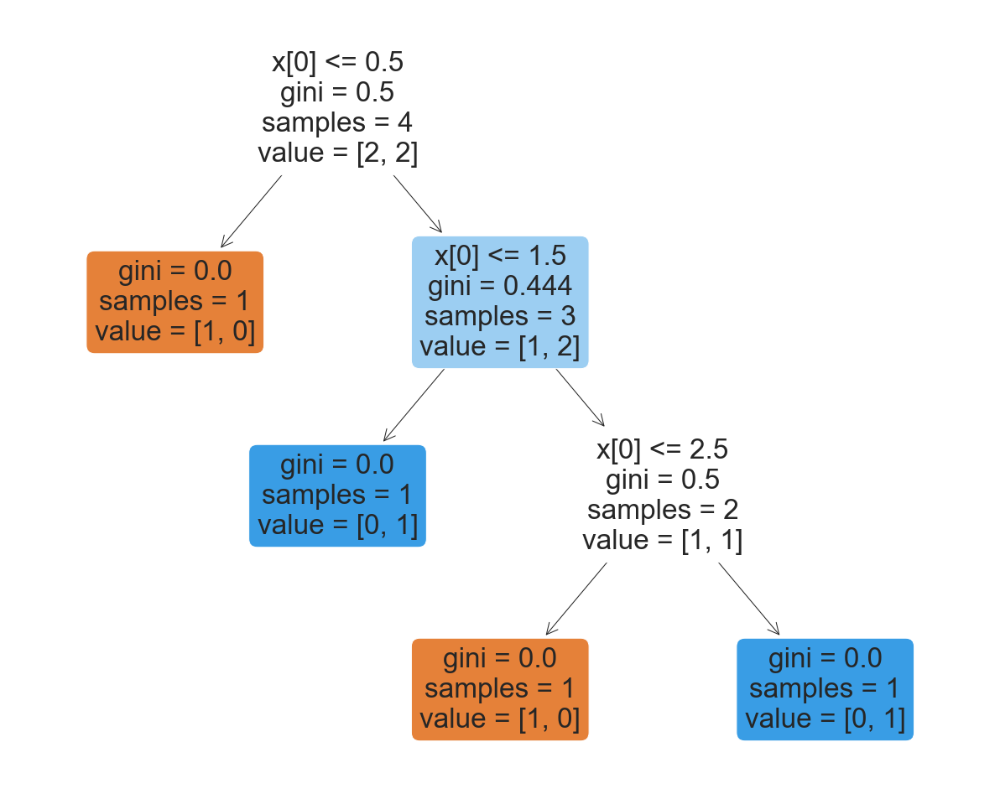

In [32]:
d_tree = DecisionTreeClassifier()
d_tree.fit(X=np.reshape([0, 1, 2, 3], (-1, 1)),
           y=[0, 1, 0, 1])
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (10,8))

tree.plot_tree(d_tree,filled=True,rounded=True,fontsize=16);

$$\mbox{Gini index}= 1 - \sum_{i=1}^N {P_i}^2$$

## Decision trees on the blob data

In [33]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
%matplotlib inline

In [35]:
blob_data, blob_labels = make_blobs(n_samples=100, random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels

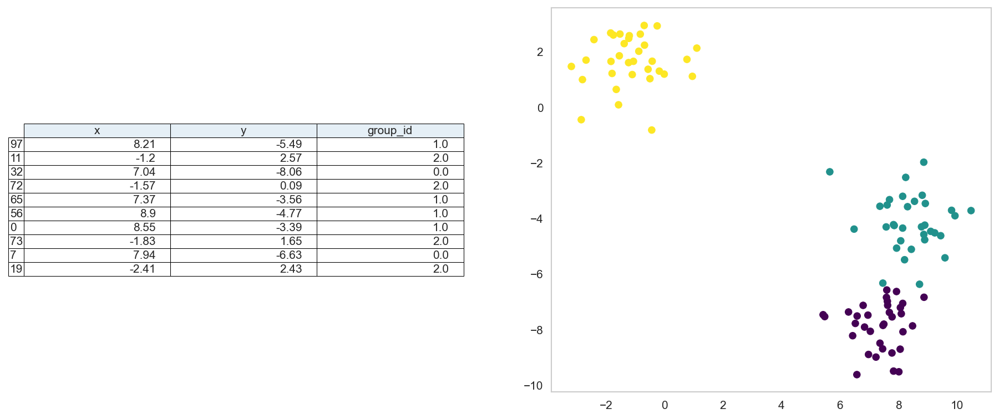

In [36]:
fig,ax = plt.subplots(1,2, figsize=(15,6),dpi=150)

ccolors = plt.cm.BuPu(np.full(3, 0.1))
pd.plotting.table(data=test_pts.sample(10).round(decimals=2), ax=ax[0], loc='center',colColours=ccolors); 
ax[0].axis('off');
ax[1].scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis');

### Train the tree

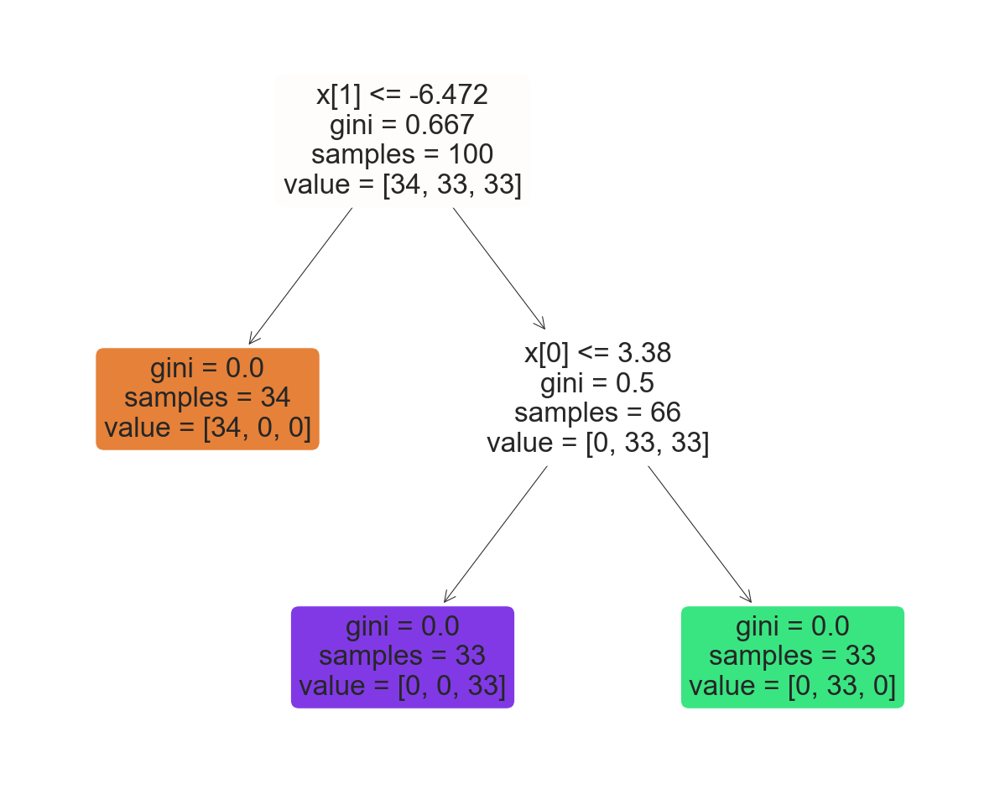

In [38]:
d_tree = DecisionTreeClassifier()
d_tree.fit(test_pts[['x', 'y']],
           test_pts['group_id'])

fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (10,8))
tree.plot_tree(d_tree,filled=True,rounded=True,fontsize=16);

### Let's look at the decision map

In [39]:
xx, yy = np.meshgrid(np.linspace(test_pts.x.min(), test_pts.x.max(), 20),
                     np.linspace(test_pts.y.min(), test_pts.y.max(), 20),
                     indexing='ij'
                     )
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
grid_pts['predicted_id'] = d_tree.predict(grid_pts[['x', 'y']])

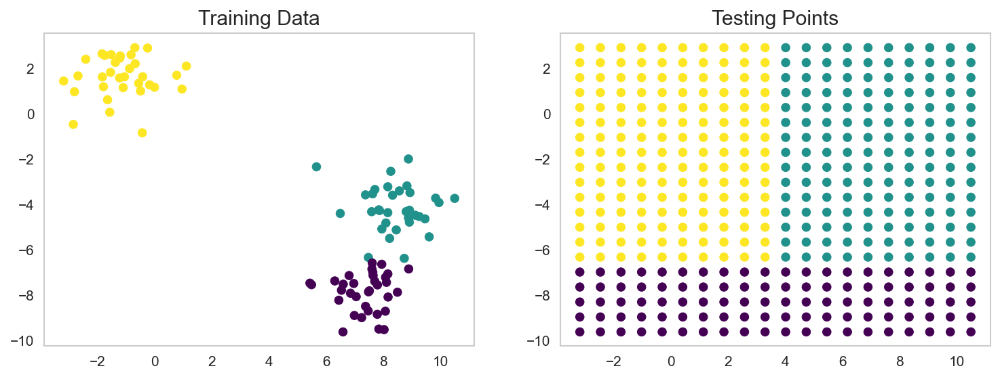

In [40]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4),dpi=150)
ax1.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis')
ax1.set_title('Training Data')
ax2.scatter(grid_pts.x, grid_pts.y, c=grid_pts.predicted_id, cmap='viridis')
ax2.set_title('Testing Points');

## Random Forests
Forests are basically the idea of taking a number of trees and bringing them together.

So rather than taking a single tree to do the classification, you divide the samples and the features to make different trees and then combine the results. One of the more successful approaches is called [Random Forests](https://en.wikipedia.org/wiki/Random_forest) or as a [video](https://www.youtube.com/watch?v=loNcrMjYh64)

```{figure} figures/np_majority.pdf
---
scale: 50%
---
Random forests train trees on different fractions of the data.
```

<img src="figures/np_majority.svg" style="height:600px"/>

In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
%matplotlib inline

__Let's make some new blob data__

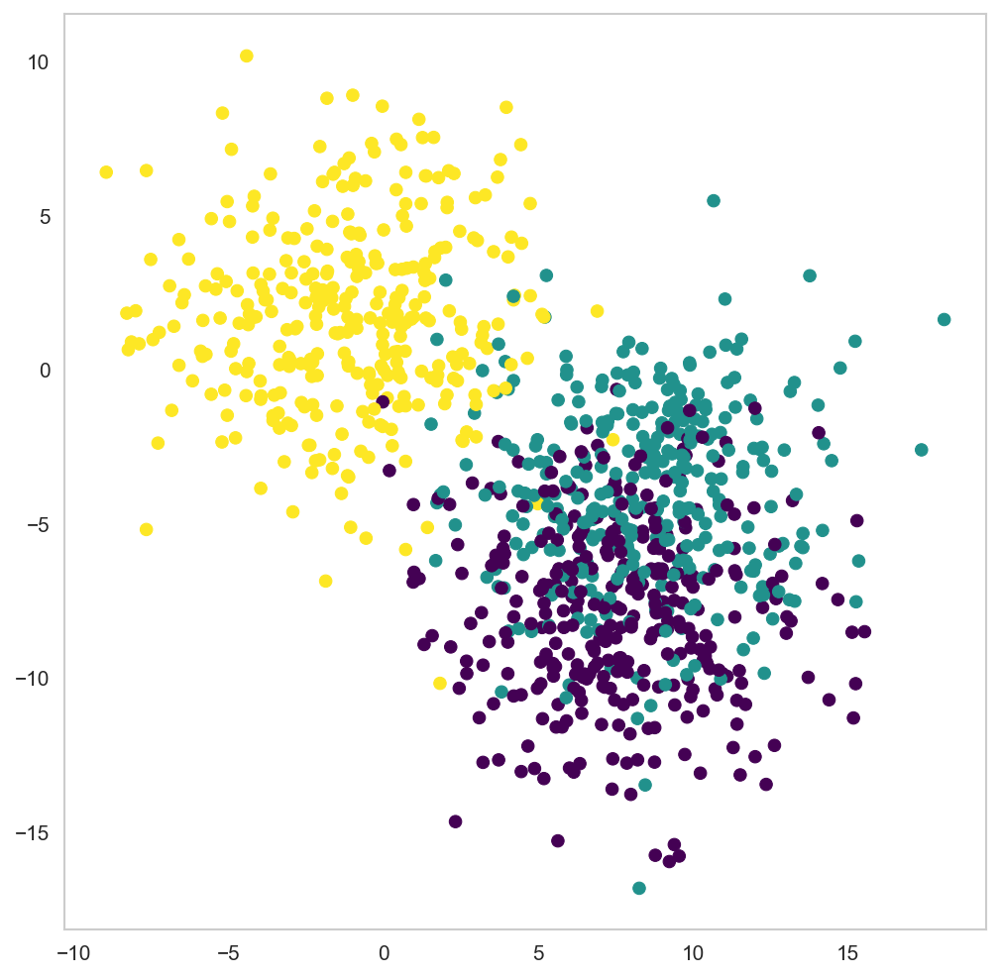

In [42]:
blob_data, blob_labels = make_blobs(n_samples=1000,
                                    cluster_std=3,
                                    random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels
plt.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis');

### Train a forest
Now we train a tiny forest with five trees.

In [43]:
from sklearn.ensemble import RandomForestClassifier
rf_class = RandomForestClassifier(n_estimators=5, random_state=2018)
rf_class.fit(test_pts[['x', 'y']], test_pts['group_id'])

print('Build ', len(rf_class.estimators_), 'decision trees')

Build  5 decision trees


### Inspect one tree
Looking at a single tree in the forest

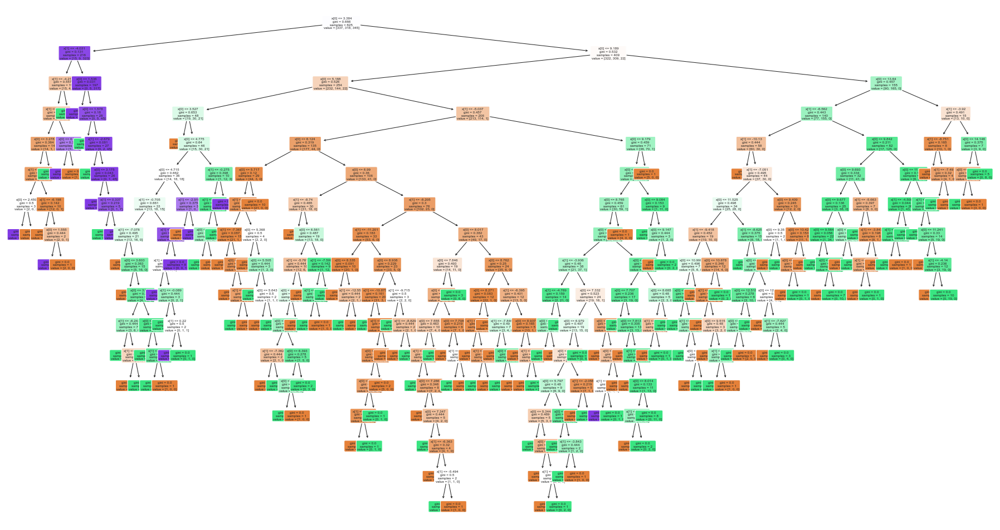

In [44]:
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (15,8))
tree.plot_tree(rf_class.estimators_[1],filled=True,rounded=True,fontsize=3);

#### Looking at the performance of the forest
Here, we'll look at how the forest behaves and some of its trees.

In [45]:
xx, yy = np.meshgrid(np.linspace(test_pts.x.min(), test_pts.x.max(), 20),
                     np.linspace(test_pts.y.min(), test_pts.y.max(), 20),
                     indexing='ij'
                     )
grid_pts = pd.DataFrame(dict(x=xx.ravel(), y=yy.ravel()))
rnd_forest_classes = rf_class.predict(grid_pts[['x', 'y']]) # Prediction of the forest

rnd_tree1          = rf_class.estimators_[0].predict(grid_pts[['x', 'y']].values) # Prediction of the first tree
rnd_tree2          = rf_class.estimators_[1].predict(grid_pts[['x', 'y']].values) # Prediction of the second tree

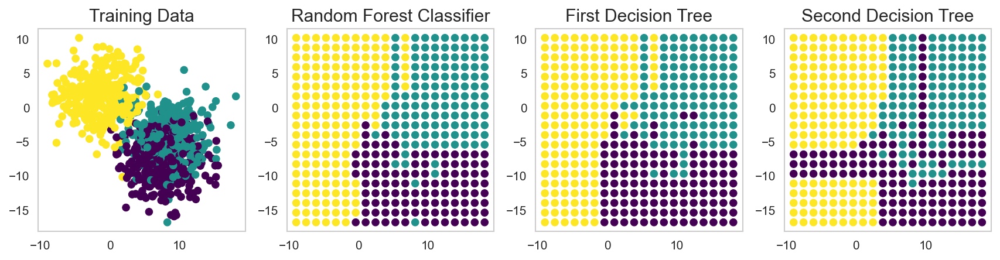

In [46]:
# Visualization
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(14, 3), dpi=150)
ax1.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis')
ax1.set_title('Training Data')
ax2.scatter(grid_pts.x, grid_pts.y, c=rnd_forest_classes, cmap='viridis')
ax2.set_title('Random Forest Classifier')

ax3.scatter(grid_pts.x, grid_pts.y, c=rnd_tree1, cmap='viridis')
ax3.set_title('First Decision Tree')

ax4.scatter(grid_pts.x, grid_pts.y, c=rnd_tree2, cmap='viridis')
ax4.set_title('Second Decision Tree');

# Pipelines

We will use the idea of pipelines generically here to refer to the combination of steps that need to be performed to solve a problem. 

<br/>
<br/>
<br/>
<center>
<img src="figures/np_workflow_4093944_000000.svg" style="height:300px"/>
</center>

Pipelines are a technical solution to reduce the amount of coding.

## Let's the return to the blobs

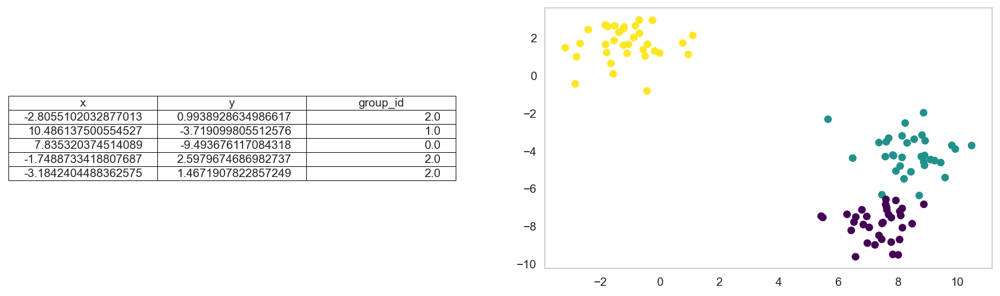

In [47]:
blob_data, blob_labels = make_blobs(n_samples=100,
                                    random_state=2018)
test_pts = pd.DataFrame(blob_data, columns=['x', 'y'])
test_pts['group_id'] = blob_labels

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 4))
cell_text = []
for row in range(5):
    cell_text.append(test_pts.sample(5).iloc[row])

ax1.table(cellText=cell_text, colLabels=test_pts.columns, loc='center'); ax1.axis('off')

ax2.scatter(test_pts.x, test_pts.y, c=test_pts.group_id, cmap='viridis');

## A basic pipeline
Our first pipeline has one step that normalizes the data using a [RobustScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.RobustScaler.html)

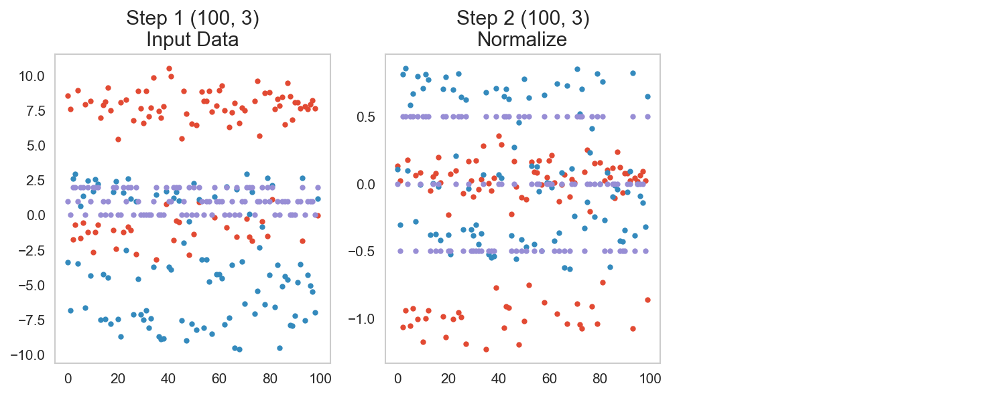

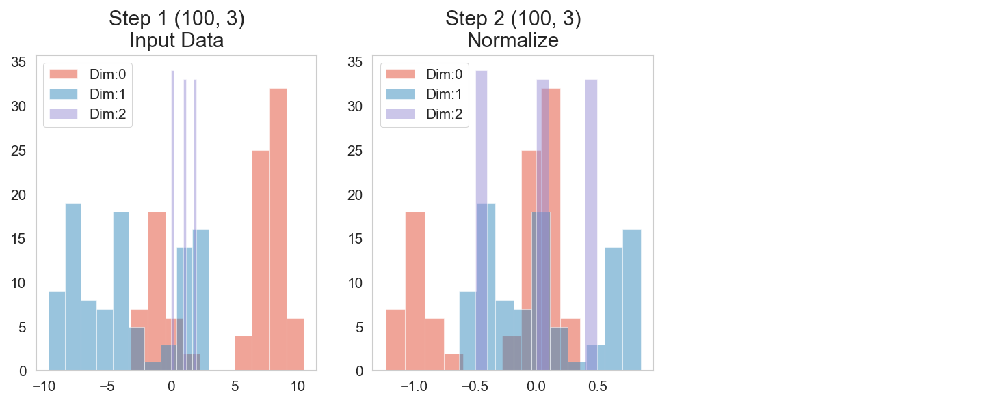

In [48]:
from pipe_utils import show_pipe
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
simple_pipe = Pipeline([('Normalize', RobustScaler())])
simple_pipe.fit(test_pts.values)

show_pipe(simple_pipe, test_pts.values)
show_pipe(simple_pipe, test_pts.values, show_hist=True, show_legend=True)

### Adding tasks to the pipeline
Next we populate the pipeline with a [QuantileTransformer](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.quantile_transform.html#sklearn.preprocessing.quantile_transform) to force the data into a uniform distribution.

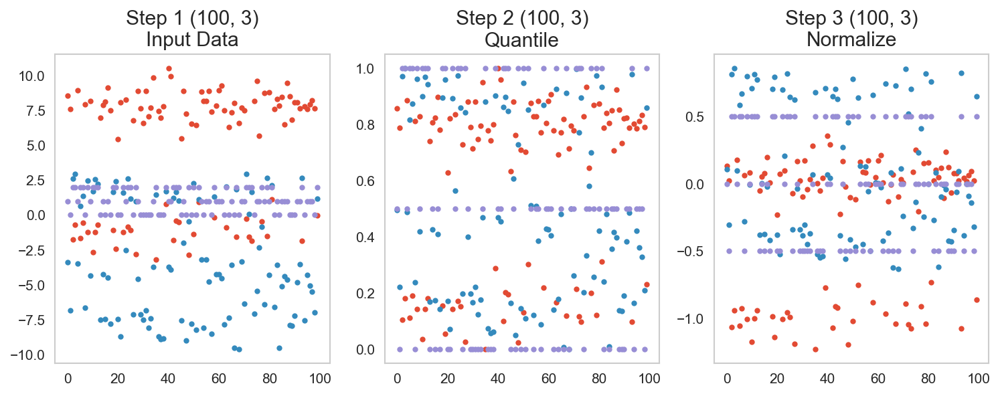

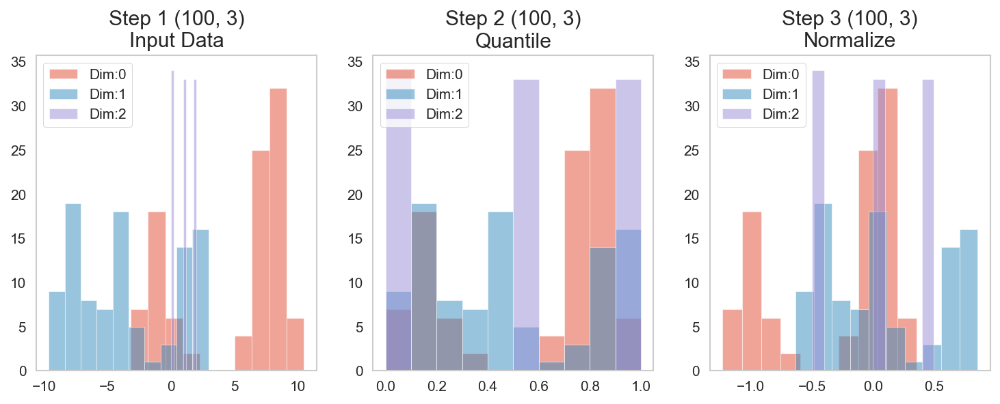

In [49]:
from sklearn.preprocessing import QuantileTransformer
longer_pipe = Pipeline([('Quantile', QuantileTransformer(n_quantiles=2)),
                        ('Normalize', RobustScaler())])
longer_pipe.fit(test_pts.values)

show_pipe(longer_pipe, test_pts.values)
show_pipe(longer_pipe, test_pts.values, show_hist=True)

### Adding polynomial features to the pipeline
We saw earlier that it can make sense to add [polynomial features](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.PolynomialFeatures.html#sklearn.preprocessing.PolynomialFeatures) to the segmentation. 

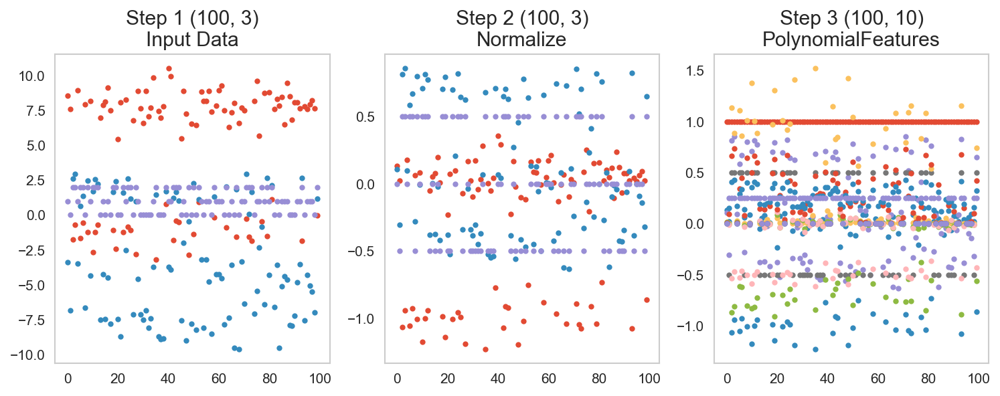

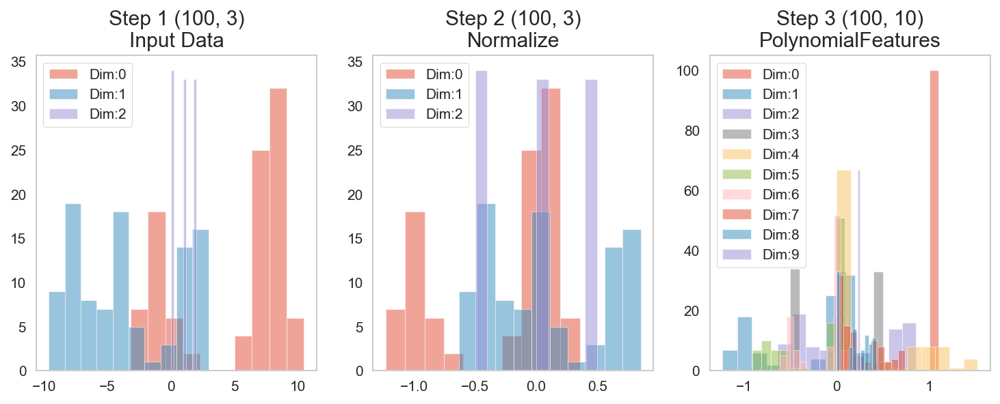

In [50]:
from sklearn.preprocessing import PolynomialFeatures
messy_pipe = Pipeline([
    ('Normalize', RobustScaler()),
    ('PolynomialFeatures', PolynomialFeatures(2))])
messy_pipe.fit(test_pts.values)

show_pipe(messy_pipe, test_pts.values)
show_pipe(messy_pipe, test_pts.values, show_hist=True)

# Classification using a pipeline

A common problem of putting images into categories. 
- The standard problem for this is classifying digits between 0 and 9 (MNIST).
- Fundamentally a classification problem is one where we are taking a large input (images, vectors, ...) and trying to put it into a category. 
    - Cats, Dogs
    - Cars, boats
    - etc.
    



## A first example with pipeline processing
### Let's load some images
- Images of numbers 0 to 9 (MNIST)
- 8 $\times$ 8 pixels
- 50 Samples

In [51]:
from sklearn.datasets import load_digits
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pipe_utils import show_pipe
%matplotlib inline

# Load the number images
digit_ds = load_digits(return_X_y=False)

# Select the first 50 images and labels
img_data = digit_ds.images[:50]
digit_id = digit_ds.target[:50]
print('Image Data', img_data.shape)

Image Data (50, 8, 8)


### Run a preprocessing pipline
- Flatten images 8 $\times$ 8 $\rightarrow$ 1 $\times$ 64
- Normalize (robust scaling)

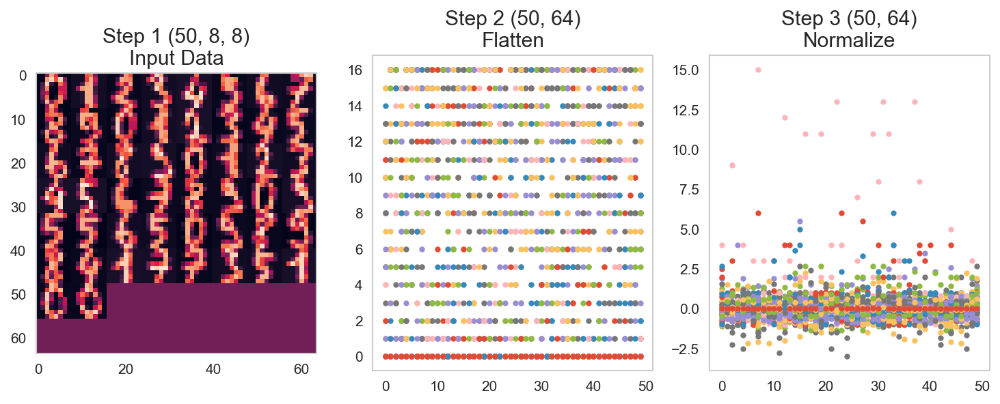

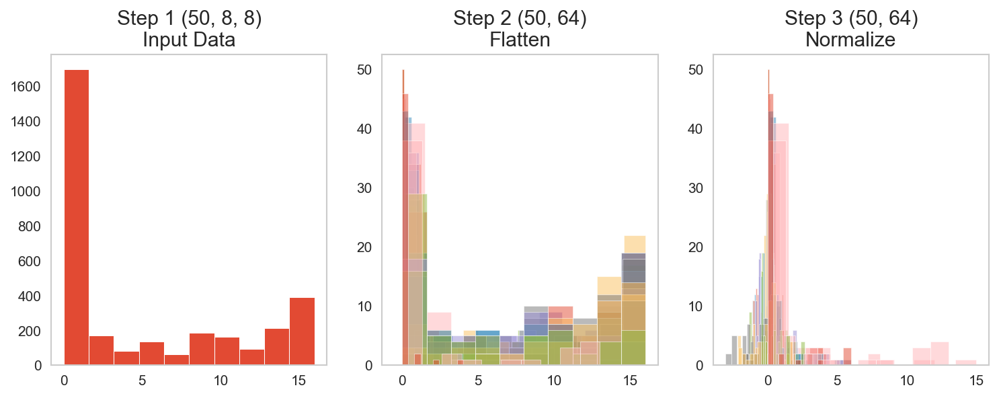

In [52]:
from pipe_utils import flatten_step
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import RobustScaler
digit_pipe = Pipeline([('Flatten', flatten_step),
                       ('Normalize', RobustScaler())])
digit_pipe.fit(img_data)

show_pipe(digit_pipe, img_data)
show_pipe(digit_pipe, img_data, show_hist=True, show_legend=False)

### Add a classifier
- Add a K Nearest Neighbours classifier to the pipeline (K=1)
- Run the fit

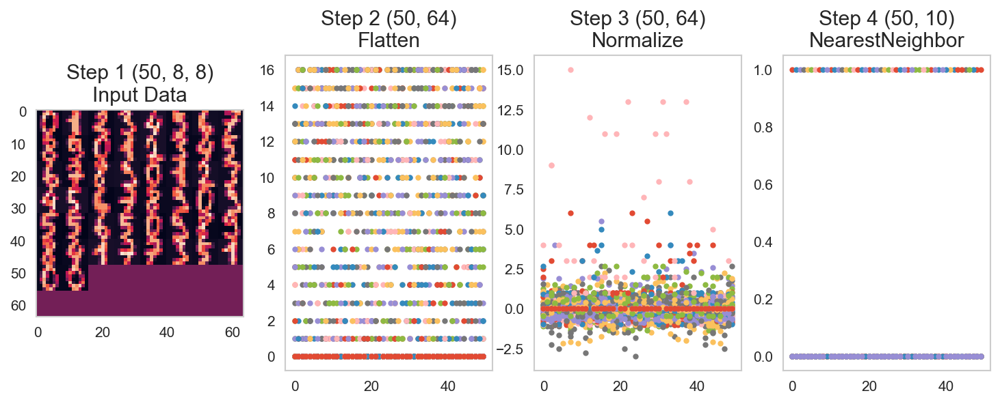

In [53]:
from sklearn.neighbors import KNeighborsClassifier

digit_class_pipe = Pipeline([('Flatten', flatten_step),
                             ('Normalize', RobustScaler()),
                             ('NearestNeighbor', KNeighborsClassifier(1))])
digit_class_pipe.fit(img_data, digit_id)

show_pipe(digit_class_pipe, img_data,panels_in_row=4)

## Test classifier performance
Let's test with traning data

In [54]:
from sklearn.metrics import accuracy_score
pred_digit = digit_class_pipe.predict(img_data)

print('{0}% accuracy'.format(100*accuracy_score(digit_id, pred_digit)))

100.0% accuracy


### How about the confusion matrix?
Let's look at the predictions in the confusion matrix.

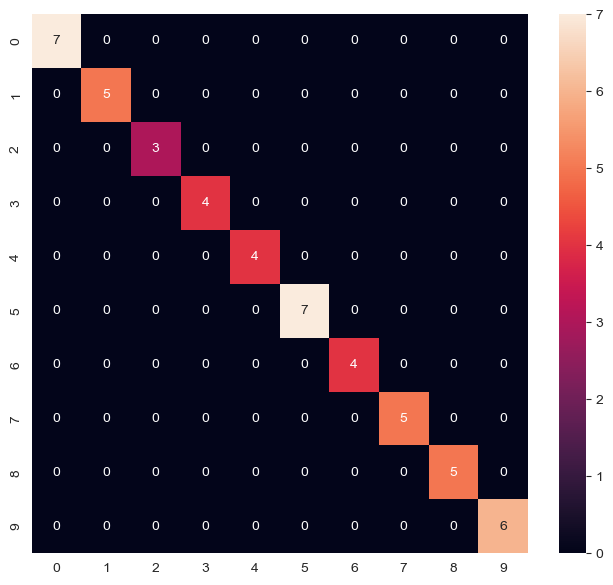

In [55]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
fig, ax1 = plt.subplots(1, 1, figsize=(8, 7), dpi=100)
sns.heatmap(
    confusion_matrix(digit_id, pred_digit),
    annot=True,
    fmt='d',
    ax=ax1);

### Reporting the classifier output
We can also look at other performance metrics using a [classification_report](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html)

In [56]:
from sklearn.metrics import classification_report
print(classification_report(digit_id, pred_digit))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         7
           1       1.00      1.00      1.00         5
           2       1.00      1.00      1.00         3
           3       1.00      1.00      1.00         4
           4       1.00      1.00      1.00         4
           5       1.00      1.00      1.00         7
           6       1.00      1.00      1.00         4
           7       1.00      1.00      1.00         5
           8       1.00      1.00      1.00         5
           9       1.00      1.00      1.00         6

    accuracy                           1.00        50
   macro avg       1.00      1.00      1.00        50
weighted avg       1.00      1.00      1.00        50



## Wow! We've built an amazing algorithm!

<img src="figures/nailedit.png" style="height:300px">

__Let's patent it! Call Google!__

### Let's try again
This just too good. Let's make a new try using new, unseen data.

Prediction: [7]
Real Value: 9


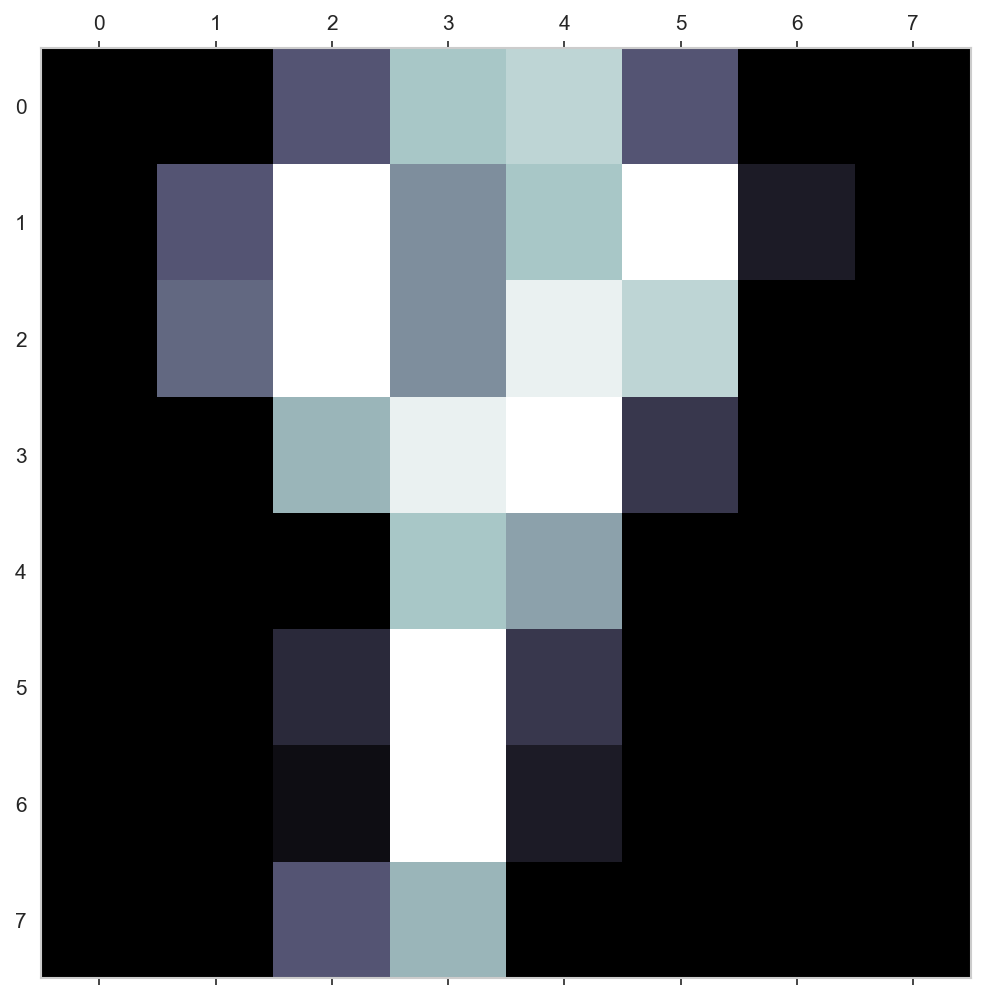

In [57]:
test_digit = np.array([[[0.,  0.,  6., 12., 13.,  6.,  0.,  0.],
                        [0.,  6., 16.,  9., 12., 16.,  2.,  0.],
                        [0.,  7., 16.,  9., 15., 13.,  0.,  0.],
                        [0.,  0., 11., 15., 16.,  4.,  0.,  0.],
                        [0.,  0.,  0., 12., 10.,  0.,  0.,  0.],
                        [0.,  0.,  3., 16.,  4.,  0.,  0.,  0.],
                        [0.,  0.,  1., 16.,  2.,  0.,  0.,  0.],
                        [0.,  0.,  6., 11.,  0.,  0.,  0.,  0.]]])
plt.matshow(test_digit[0], cmap='bone')
print('Prediction:', digit_class_pipe.predict(test_digit))
print('Real Value:', 9)

## Training, Validation, and Testing

__Avoid the training "crime" in ML__

<div class="row">
    <div class="column23">
        <center>
<img src="figures/dataiku-holdout-strategy.jpg" style="height:600px"/>
            </center>
    </div>
    <div class="column13">
<img src="figures/jail.png" style="height:500px"/>
</div>
</div>

https://www.kdnuggets.com/2017/08/dataiku-predictive-model-holdout-cross-validation.html

# Regression using a pipeline
For regression, we can see 
- it is very similarly to a classification 
    - Predicts the category
    
- instead of trying to output discrete classes we can output on a continuous scale. 
    - Predicts the __actual decimal number__.



In [58]:
from sklearn.datasets import load_digits
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from pipe_utils import show_pipe, flatten_step
%matplotlib inline

## Load the digits data again
This time we load 
- 50 image/label pairs for the training
- 450 images/label pairs for the validation

In [59]:
digit_ds = load_digits(return_X_y=False)

img_data = digit_ds.images[:50]
digit_id = digit_ds.target[:50]

valid_data = digit_ds.images[50:500]
valid_id = digit_ds.target[50:500]

## Run a KNeighbors regression
In this pipeline we will make a [regression based on K-Neighbors](https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsRegressor.html?highlight=kneighborsregression).

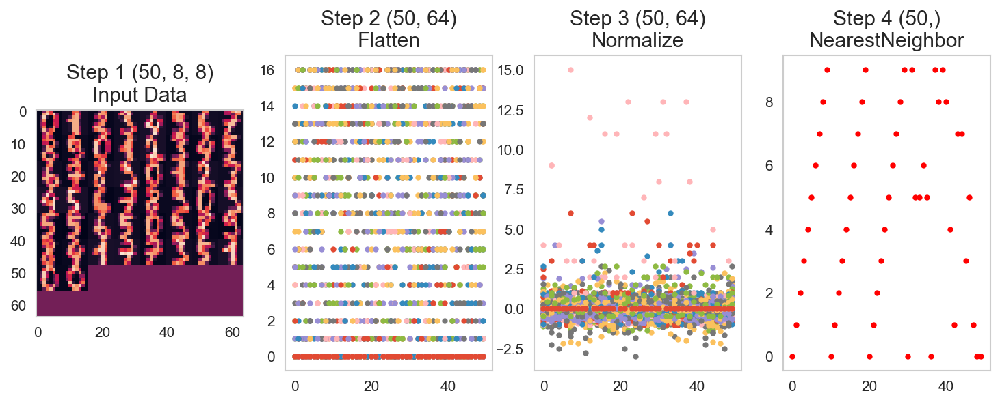

In [60]:
from sklearn.neighbors import KNeighborsRegressor

digit_regress_pipe = Pipeline([('Flatten', flatten_step),
                               ('Normalize', RobustScaler()),
                               ('NearestNeighbor', KNeighborsRegressor(1))])
digit_regress_pipe.fit(img_data, digit_id)

show_pipe(digit_regress_pipe, img_data, panels_in_row=4)

# Assessment of multi-category data
We can't use accuracy, ROC, precision, recall or any of these factors anymore since we don't have binary / true-or-false conditions we are trying to predict. We know have to go back to some of the initial metrics we covered in the first lectures.

$$ MSE = \frac{1}{N}\sum \left(y_{predicted} - y_{actual}\right)^2 $$

$$ MAE = \frac{1}{N}\sum |y_{predicted} - y_{actual}| $$

/Users/kaestner/miniconda3/lib/python3.9/site-packages/seaborn/categorical.py:3544: UserWarning: 6.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


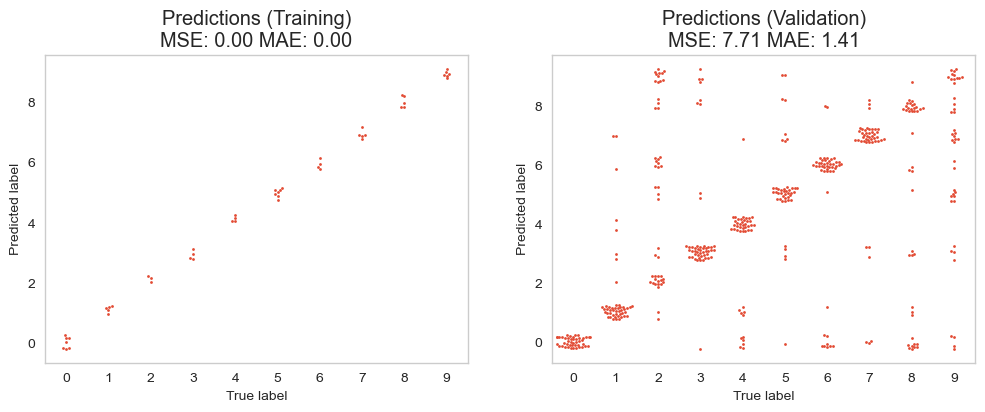

In [61]:

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4), dpi=100)
pred_train = digit_regress_pipe.predict(img_data)
jitter = lambda x: x+0.25*np.random.uniform(-1, 1, size=x.shape)
sns.swarmplot(x=digit_id, y=jitter(pred_train), ax=ax1,size=2)
ax1.set_title('Predictions (Training)\nMSE: %2.2f MAE: %2.2f' % (np.mean(np.square(pred_train-digit_id)),
                                                                 np.mean(np.abs(pred_train-digit_id))))
ax1.set_xlabel('True label'), ax1.set_ylabel('Predicted label')

pred_valid = digit_regress_pipe.predict(valid_data)
sns.swarmplot(x=valid_id, y=jitter(pred_valid), ax=ax2,size=2)
ax2.set_title('Predictions (Validation)\nMSE: %2.2f MAE: %2.2f' % (np.mean(np.square(pred_valid-valid_id)),
                                                                   np.mean(np.abs(pred_valid-valid_id))));
ax2.set_xlabel('True label'), ax2.set_ylabel('Predicted label');

## Increasing neighbor count

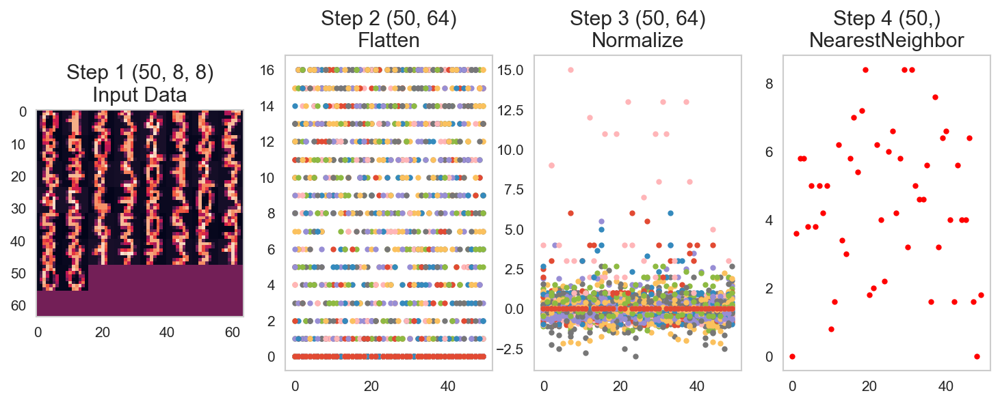

In [62]:
digit_regress_pipe = Pipeline([('Flatten', flatten_step), ('Normalize', RobustScaler()), ('NearestNeighbor', KNeighborsRegressor(5))])
digit_regress_pipe.fit(img_data, digit_id)

show_pipe(digit_regress_pipe, img_data, panels_in_row=4)

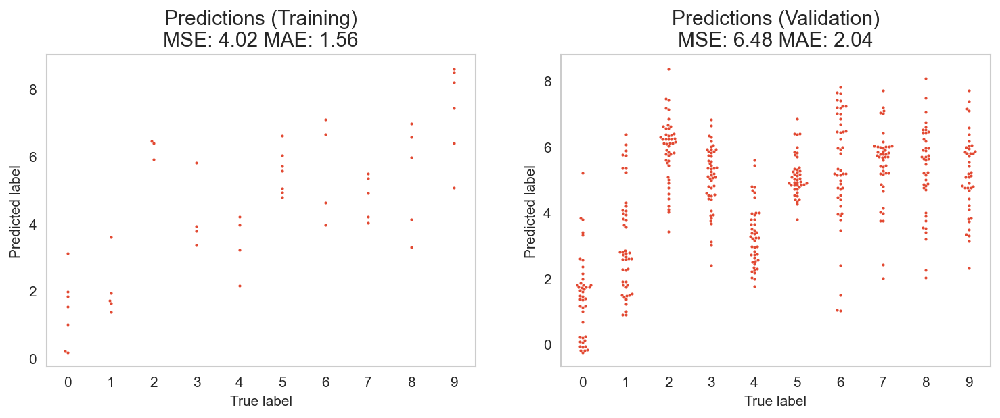

In [63]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
pred_train = digit_regress_pipe.predict(img_data)

sns.swarmplot(x=digit_id, y=jitter(pred_train), ax=ax1,size=2)
ax1.set_title('Predictions (Training)\nMSE: %2.2f MAE: %2.2f' % (np.mean(np.square(pred_train-digit_id)),
                                                                 np.mean(np.abs(pred_train-digit_id))))

ax1.set_xlabel('True label'), ax1.set_ylabel('Predicted label')
pred_valid = digit_regress_pipe.predict(valid_data)
sns.swarmplot(x=valid_id, y=jitter(pred_valid), ax=ax2,size=2)
ax2.set_title('Predictions (Validation)\nMSE: %2.2f MAE: %2.2f' % (np.mean(np.square(pred_valid-valid_id)),
                                                                   np.mean(np.abs(pred_valid-valid_id))));
ax2.set_xlabel('True label'), ax2.set_ylabel('Predicted label');

# Segmentation (Pixel Classification)

__Previously__
Predict something based on the information in the image
- Single class (classification)
- Values (regression)

__Segmentation__
Now we want to change problem:
- instead of assigning a single class for each image, 
- we want a class or value for each pixel. 

This requires that we restructure the problem.

## Where segmentation fails: Mitochondria Segmentation in EM

<img src="data/em_image.png" style="height:400px" />

- The mitocondria are visible and humans easily spot them
- Other structures have same gray levels
- SNR is not ideal

*** 

- A simple threshold is insufficient to finding the mitocondria structures
- Other filtering techniques are unlikely to magicially fix this problem


## Let's try some methods to segment the mitochondria image

1. __Decision trees__
    - DecisionTreeRegressor
    - DecisionTreeRegressor with position
2. __Random forests__
    - Random forest + KMeans
    - Random forest + polynomials
    - Random forest + Filters 
3. __Linear regression__
     - Neighborhood
4. __Nearest neighbor__
     - KNeighborsRegressor
5. __U-Net__

## Preparing the mitchondria image and mask
First we need image data for:
- Training
- Validation

In [64]:
cell_img = (imread("data/em_image.png")[::2, ::2])/255.0
cell_seg = imread("data/em_image_seg.png",
                  as_gray=True)[::2, ::2] > 0
np.random.seed(2018)

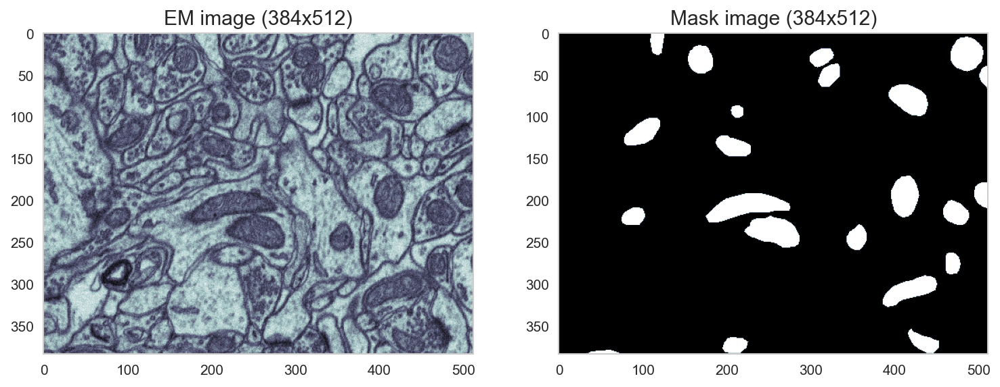

In [65]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 8), dpi=150)
ax1.imshow(cell_img, cmap='bone'); ax1.set_title("EM image ({0}x{1})".format(cell_img.shape[0],cell_img.shape[1]))
ax2.imshow(cell_seg, cmap='bone'); ax2.set_title("Mask image ({0}x{1})".format(cell_seg.shape[0],cell_seg.shape[1]));

### Training and validation data
We only have one image available...

__Solution:__ Split it into two parts!

In [66]:
train_img, valid_img = cell_img[:, :256], cell_img[:, 256:]
train_mask, valid_mask = cell_seg[:, :256], cell_seg[:, 256:]

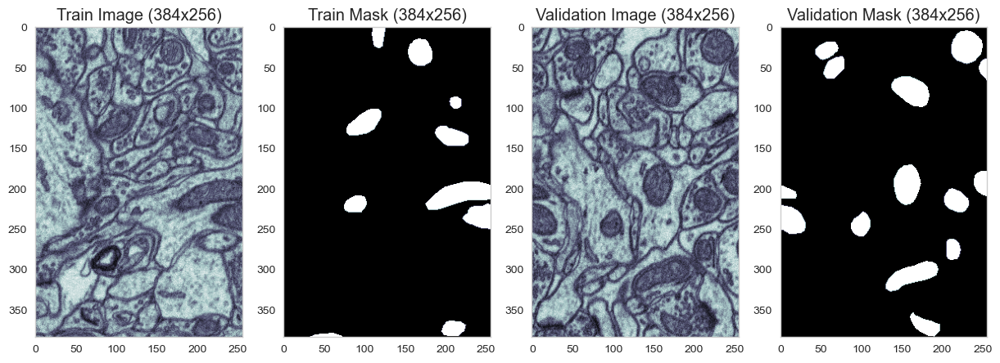

In [67]:
fig, ((ax1, ax2,ax3, ax4)) = plt.subplots(1, 4, figsize=(15, 5), dpi=100)
ax1.imshow(train_img, cmap='bone');  ax1.set_title('Train Image ({0}x{1})'.format(train_img.shape[0],train_img.shape[1]))
ax2.imshow(train_mask, cmap='bone'); ax2.set_title('Train Mask ({0}x{1})'.format(train_mask.shape[0],train_mask.shape[1]))

ax3.imshow(valid_img,  cmap='bone'); ax3.set_title('Validation Image ({0}x{1})'.format(valid_img.shape[0],valid_img.shape[1]))
ax4.imshow(valid_mask, cmap='bone'); ax4.set_title('Validation Mask ({0}x{1})'.format(valid_mask.shape[0],valid_mask.shape[1]));

## Try a Regression tree

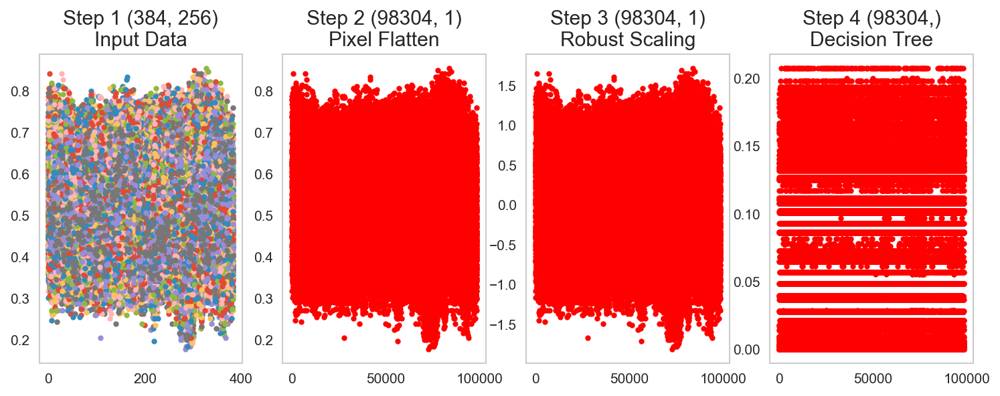

In [68]:
from pipe_utils import px_flatten_func, fit_img_pipe
px_flatten_step = FunctionTransformer(px_flatten_func, validate=False) 
rf_seg_model = Pipeline([('Pixel Flatten',  px_flatten_step),
                         ('Robust Scaling', RobustScaler()),
                         ('Decision Tree',  DecisionTreeRegressor())
                         ])

pred_func = fit_img_pipe(rf_seg_model, train_img, train_mask)
show_pipe(rf_seg_model, train_img,panels_in_row=4)
show_tree(rf_seg_model.steps[-1][1]);

### Segmentation results from the regression tree

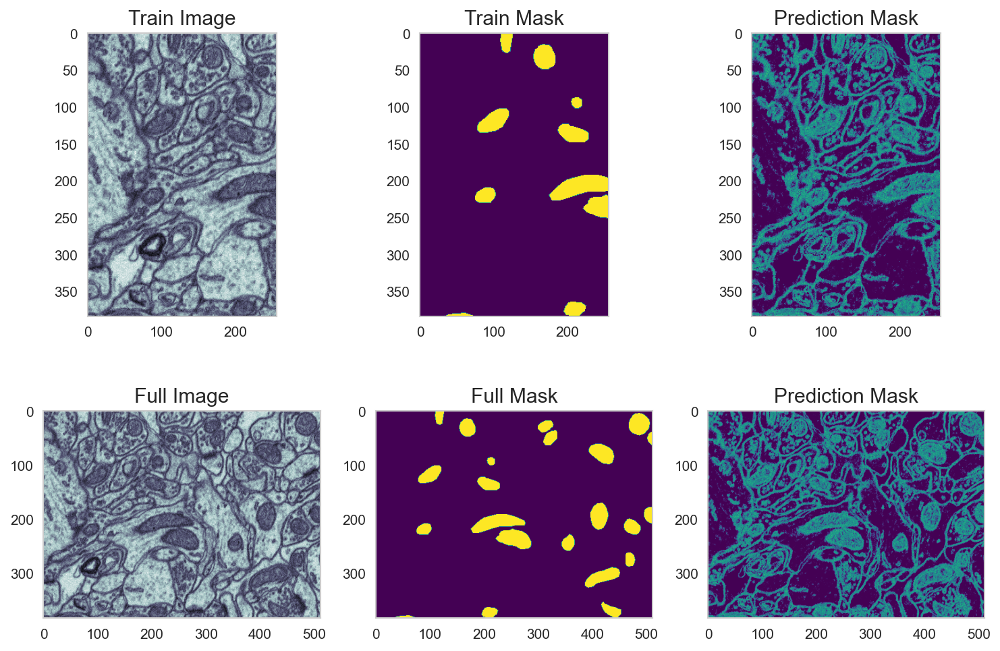

In [69]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots(2, 3, figsize=(12, 8), dpi=150)
ax1.imshow(train_img, cmap='bone')
ax1.set_title('Train Image')

ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')

ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=0.3); ax2.set_title('Prediction Mask')

ax3.imshow(cell_img, cmap='bone'); ax3.set_title('Full Image')

ax6.imshow(cell_seg, cmap='viridis'); ax6.set_title('Full Mask')

ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=0.3); ax4.set_title('Prediction Mask');

## Regression tree with _position information_

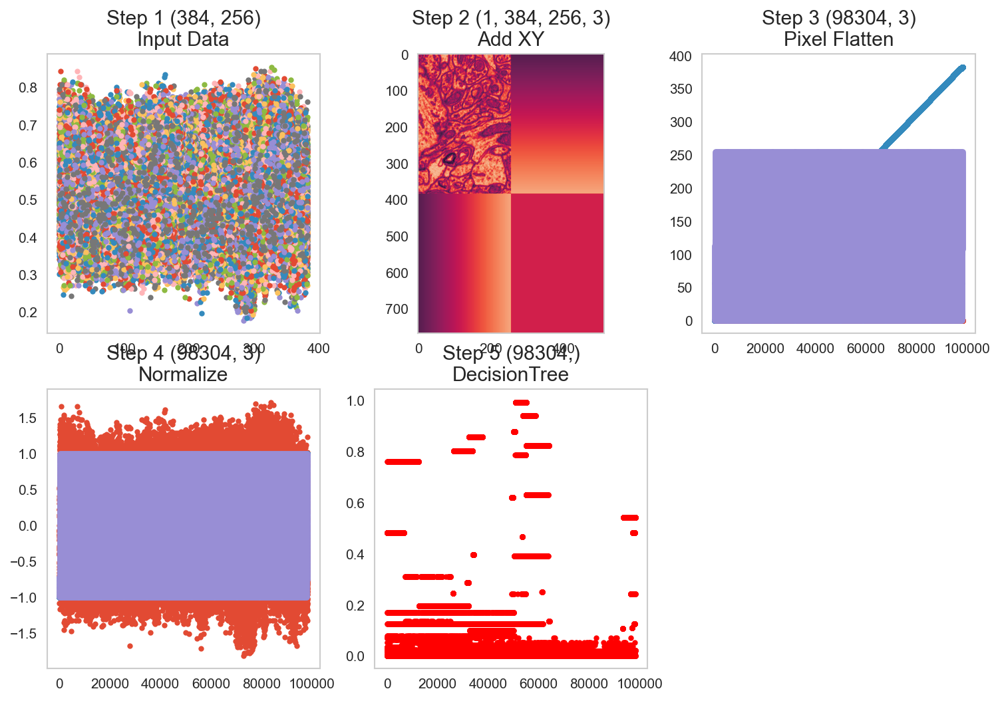

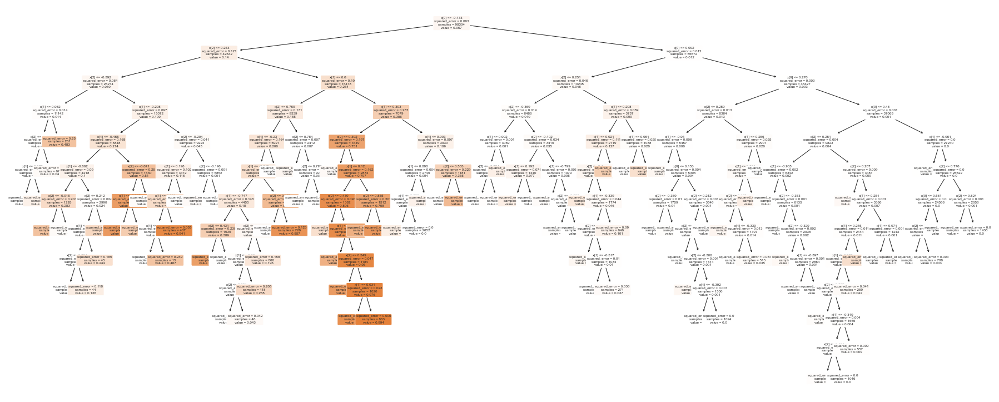

In [70]:
from pipe_utils import xy_step

rf_xyseg_model = Pipeline([('Add XY', xy_step),
                           ('Pixel Flatten', px_flatten_step),
                           ('Normalize', RobustScaler()),
                           ('DecisionTree', DecisionTreeRegressor(
                               min_samples_split=1000))
                           ])

pred_func = fit_img_pipe(rf_xyseg_model, train_img, train_mask)
show_pipe(rf_xyseg_model, train_img)
plt.figure(figsize=(15,6))
tree.plot_tree(rf_xyseg_model.steps[-1][1],fontsize=3,filled=True,rounded=True);

### Did the segmentation performance improve?

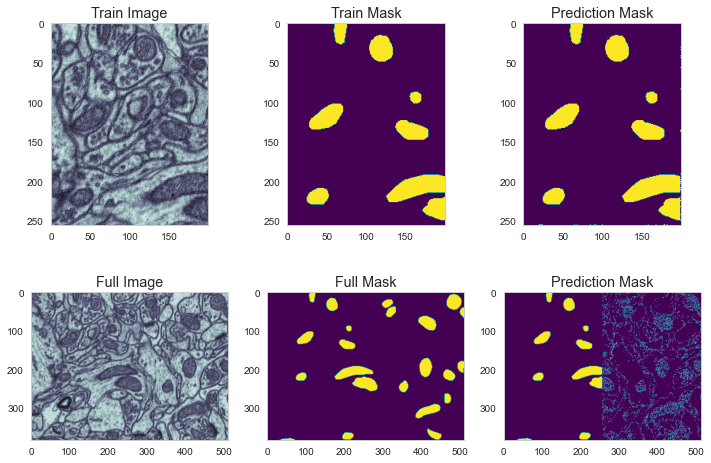

In [91]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots(2, 3, figsize=(12, 8), dpi=72)
ax1.imshow(train_img, cmap='bone');ax1.set_title('Train Image')
ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')
ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax2.set_title('Prediction Mask')
ax3.imshow(cell_img, cmap='bone'); ax3.set_title('Full Image')
ax6.imshow(cell_seg, cmap='viridis'); ax6.set_title('Full Mask')
ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1);ax4.set_title('Prediction Mask');

## Combine K-Means and Random Forest Regression 

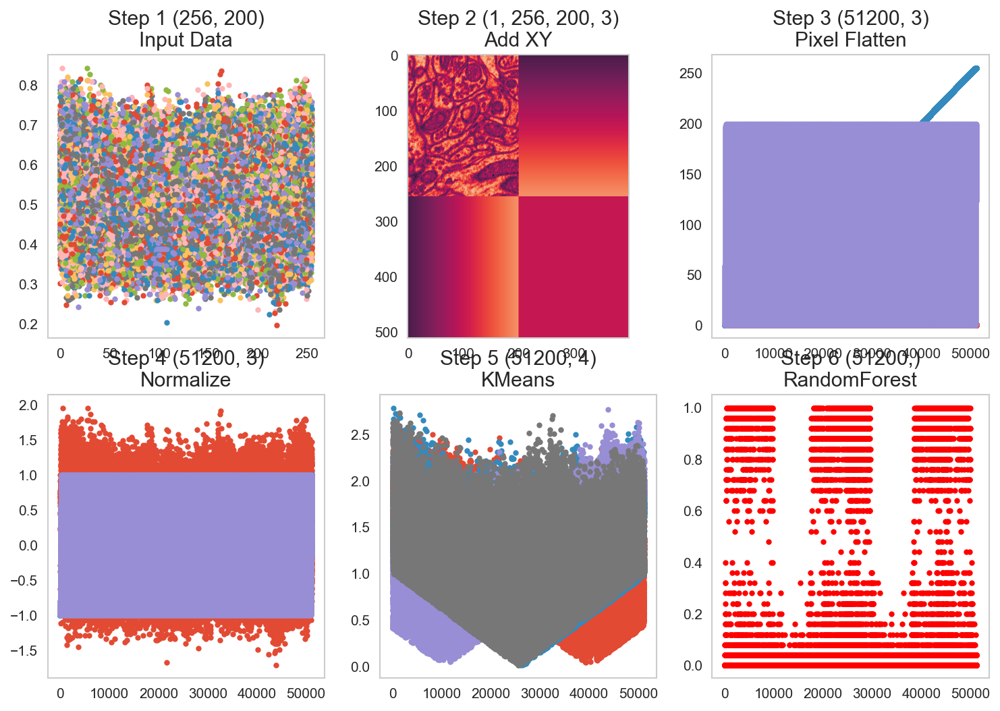

In [92]:
from sklearn.cluster import KMeans
rf_xyseg_k_model = Pipeline([('Add XY', xy_step),
                             ('Pixel Flatten', px_flatten_step),
                             ('Normalize', RobustScaler()),
                             ('KMeans', KMeans(4,n_init='auto')),
                             ('RandomForest', RandomForestRegressor(n_estimators=25))
                             ])

pred_func = fit_img_pipe(rf_xyseg_k_model, train_img, train_mask)
show_pipe(rf_xyseg_k_model, train_img)

### Did it improve now?

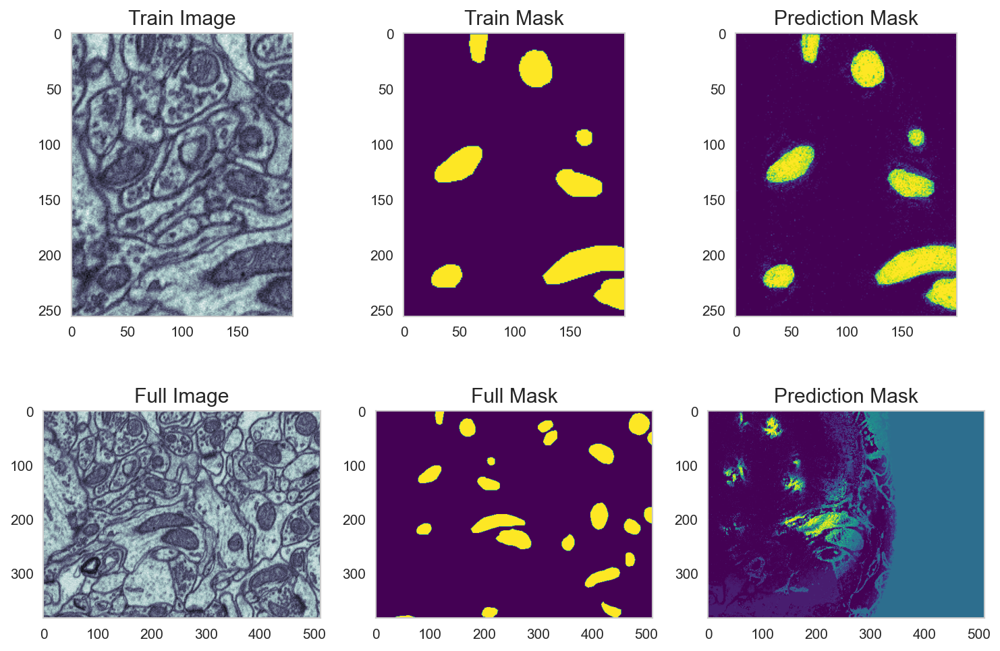

In [93]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots(2, 3, figsize=(12, 8), dpi=150)
ax1.imshow(train_img, cmap='bone'); ax1.set_title('Train Image')
ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')
ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax2.set_title('Prediction Mask')
ax3.imshow(cell_img, cmap='bone'); ax3.set_title('Full Image')
ax6.imshow(cell_seg, cmap='viridis'); ax6.set_title('Full Mask')
ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax4.set_title('Prediction Mask');

## Trying polynomial features 

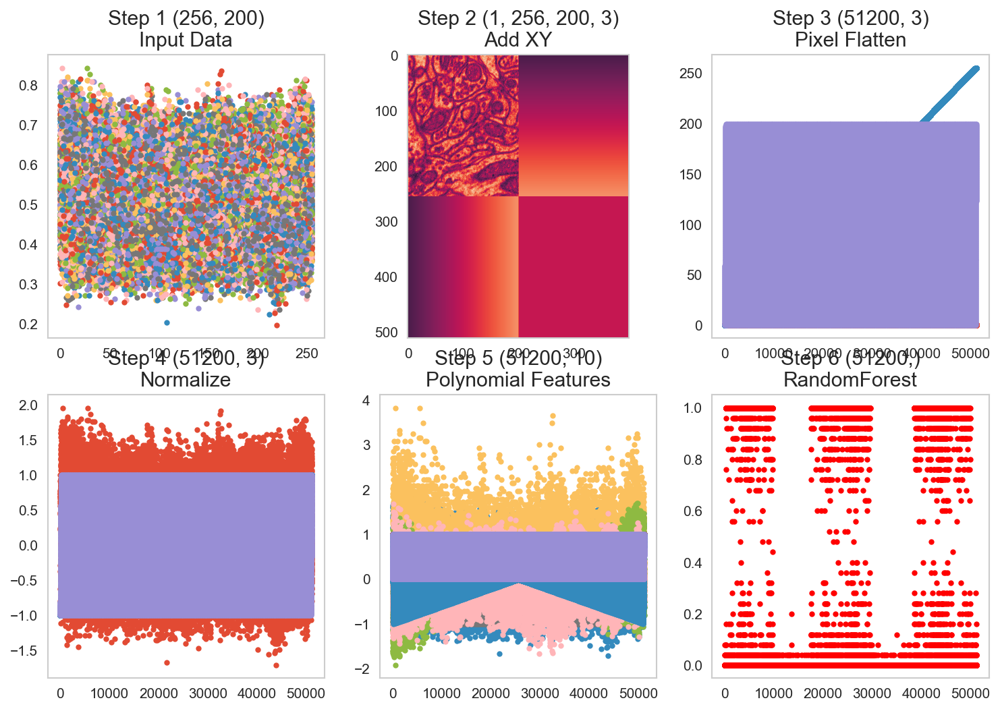

In [95]:
from sklearn.preprocessing import PolynomialFeatures
from pipe_utils import add_xy_coord
xy_step = FunctionTransformer(add_xy_coord, validate=False)
rf_xyseg_py_model = Pipeline([('Add XY', xy_step),
                              ('Pixel Flatten', px_flatten_step),
                              ('Normalize', RobustScaler()),
                              ('Polynomial Features', PolynomialFeatures(2)),
                              ('RandomForest', RandomForestRegressor(n_estimators=25))
                              ])

pred_func = fit_img_pipe(rf_xyseg_py_model, train_img, train_mask)
show_pipe(rf_xyseg_py_model, train_img)

### What happens with this complicated pipeline?
We...
- Added XY position
- Normalized 
- Added polynomial features
- Used a random forest regressor with 25 trees

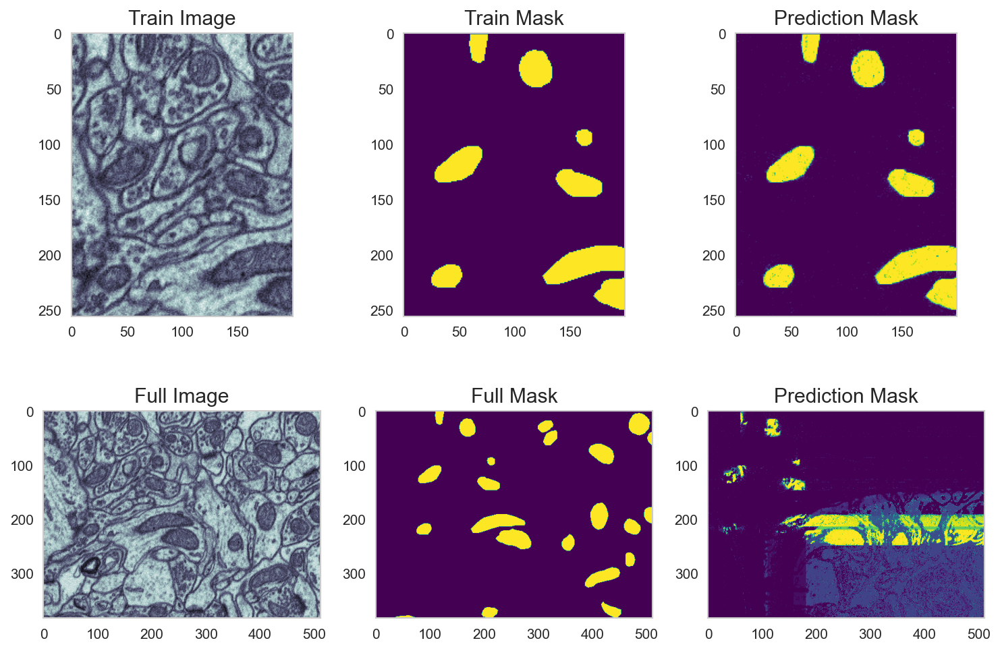

In [96]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots(2, 3, figsize=(12, 8), dpi=150)
ax1.imshow(train_img, cmap='bone')
ax1.set_title('Train Image')

ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')

ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax2.set_title('Prediction Mask')

ax3.imshow(cell_img, cmap='bone'); ax3.set_title('Full Image')

ax6.imshow(cell_seg, cmap='viridis'); ax6.set_title('Full Mask')

ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax4.set_title('Prediction Mask');

## Adding smarter features
Here we add images with weighted neighborhood information using filters based on Gaussians

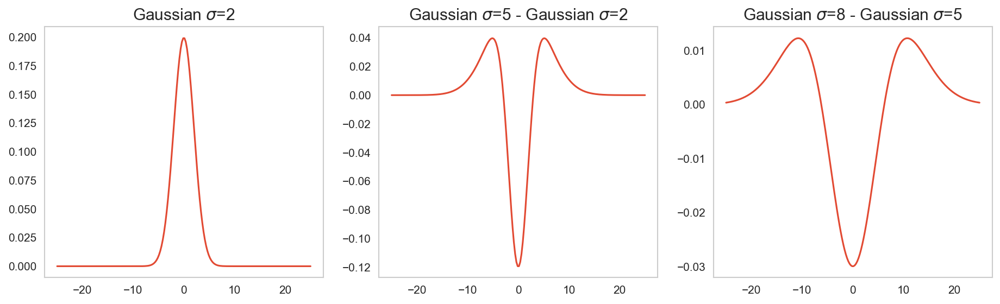

In [99]:
import scipy.stats as stats 
x=np.linspace(-25,25,200)
fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=[15,4])
ax1.plot(x,stats.norm.pdf(x,0,2)); ax1.set_title("Gaussian $\sigma$=2");
ax2.plot(x,stats.norm.pdf(x,0,5)-stats.norm.pdf(x,0,2)), ax2.set_title("Gaussian $\sigma$=5 - Gaussian $\sigma$=2");
ax3.plot(x,stats.norm.pdf(x,0,8)-stats.norm.pdf(x,0,5)), ax3.set_title("Gaussian $\sigma$=8 - Gaussian $\sigma$=5");

### Pipeline with filters

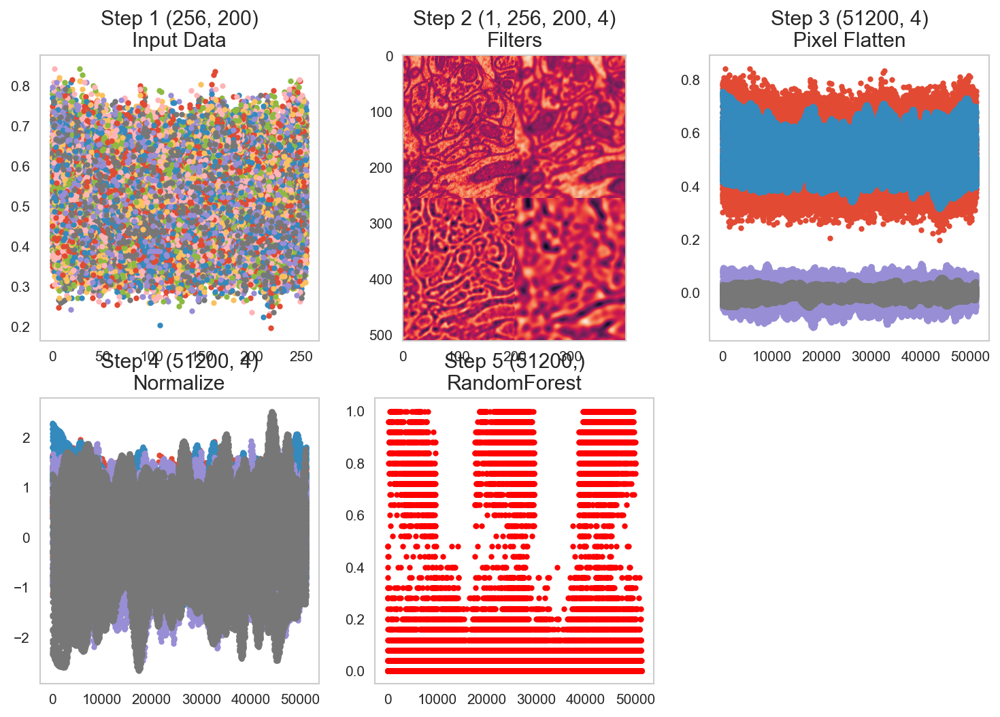

In [100]:
from pipe_utils import filter_step
rf_filterseg_model = Pipeline([('Filters', filter_step),
                               ('Pixel Flatten', px_flatten_step),
                               ('Normalize', RobustScaler()),
                               ('RandomForest', RandomForestRegressor(n_estimators=25))
                               ])

pred_func = fit_img_pipe(rf_filterseg_model, train_img, train_mask)
show_pipe(rf_filterseg_model, train_img)

### Results with features based on filters

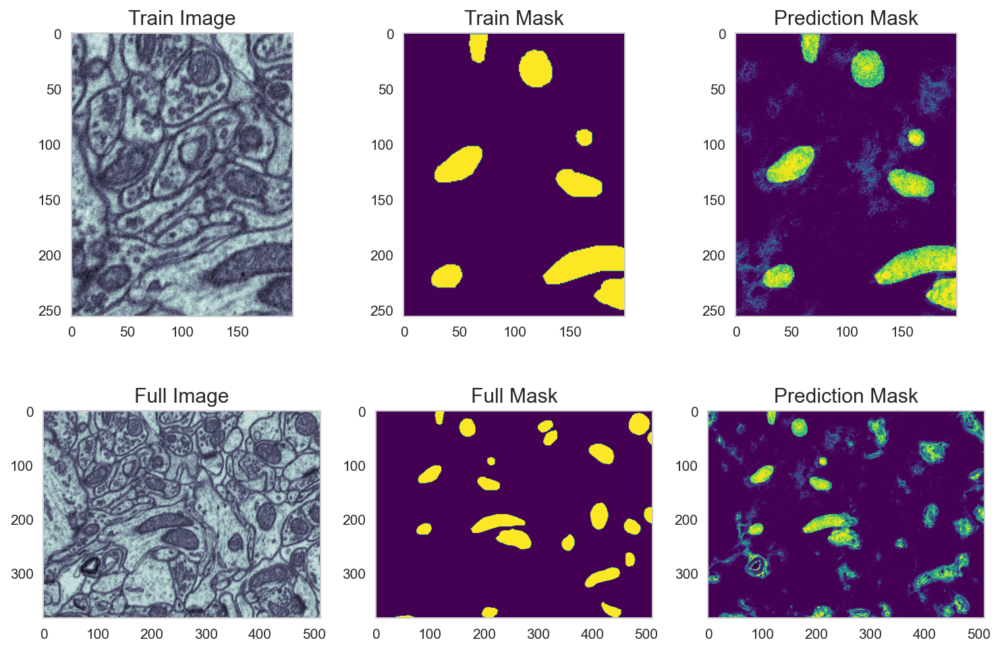

In [101]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots( 2, 3, figsize=(12, 8), dpi=150)
ax1.imshow(train_img, cmap='bone'); ax1.set_title('Train Image')

ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')

ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax2.set_title('Prediction Mask')

ax3.imshow(cell_img, cmap='bone'); ax3.set_title('Full Image')

ax6.imshow(cell_seg, cmap='viridis'); ax6.set_title('Full Mask')

ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax4.set_title('Prediction Mask');

## Using the Neighborhood
We can also include the whole neighborhood 
- shifting the image in x and y by $\pm$1 pixel. 
- Gives nine feature images

For the first example we will then use __linear regression__ so we can see the exact coefficients that result.

### Some code to create the neighborhood

In [102]:
from sklearn.preprocessing import FunctionTransformer

def add_neighborhood(in_x, x_steps=3, y_steps=3):
    if len(in_x.shape) == 2:   x = np.expand_dims(np.expand_dims(in_x, 0), -1)
    elif len(in_x.shape) == 3: x = np.expand_dims(in_x, -1)
    elif len(in_x.shape) == 4: x = in_x
    else:
        raise ValueError('Cannot work with images with dimensions {}'.format(in_x.shape))
        
    n_img, x_dim, y_dim, c_dim = x.shape
    out_imgs = []
    for i in range(-x_steps, x_steps+1):
        for j in range(-y_steps, y_steps+1):
            out_imgs += [np.roll(np.roll(x,axis=1, shift=i), axis=2, shift=j)]
    return np.concatenate(out_imgs, -1)

def neighbor_step(x_steps=3, y_steps=3):
    return FunctionTransformer(
        lambda x: add_neighborhood(x, x_steps, y_steps),
        validate=False)

### Pipeline with neighborhood features

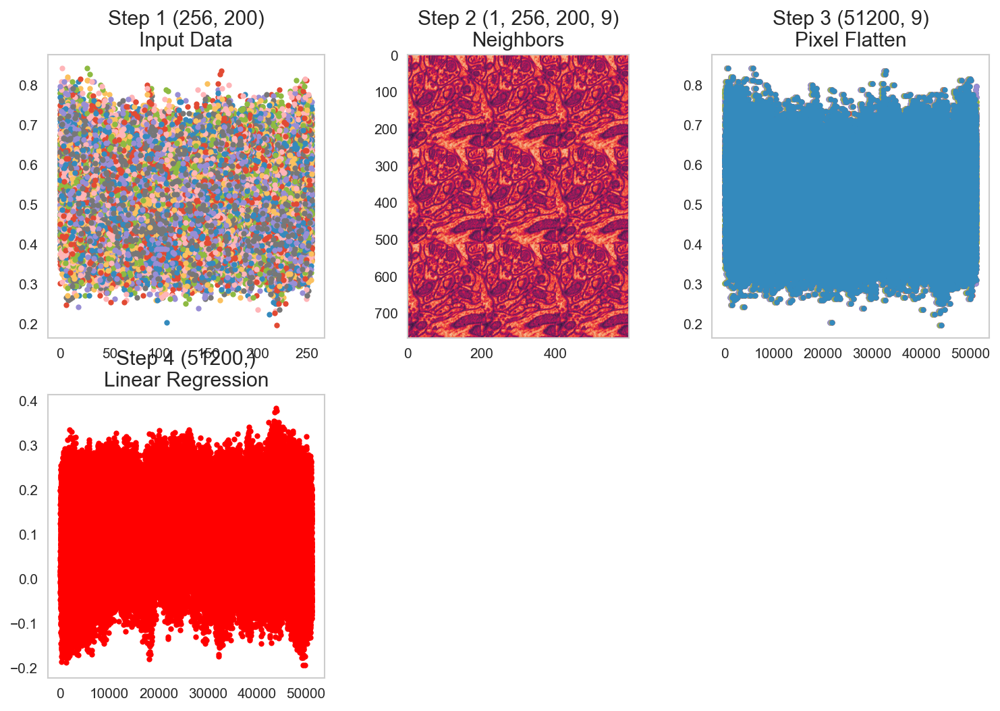

In [104]:
from sklearn.linear_model import LinearRegression
linreg_neighborseg_model = Pipeline([('Neighbors', neighbor_step(1, 1)),
                               ('Pixel Flatten', px_flatten_step),
                               ('Linear Regression', LinearRegression())
                               ])

pred_func = fit_img_pipe(linreg_neighborseg_model, train_img, train_mask)
show_pipe(linreg_neighborseg_model, train_img)

### Result of neighborhood regression 

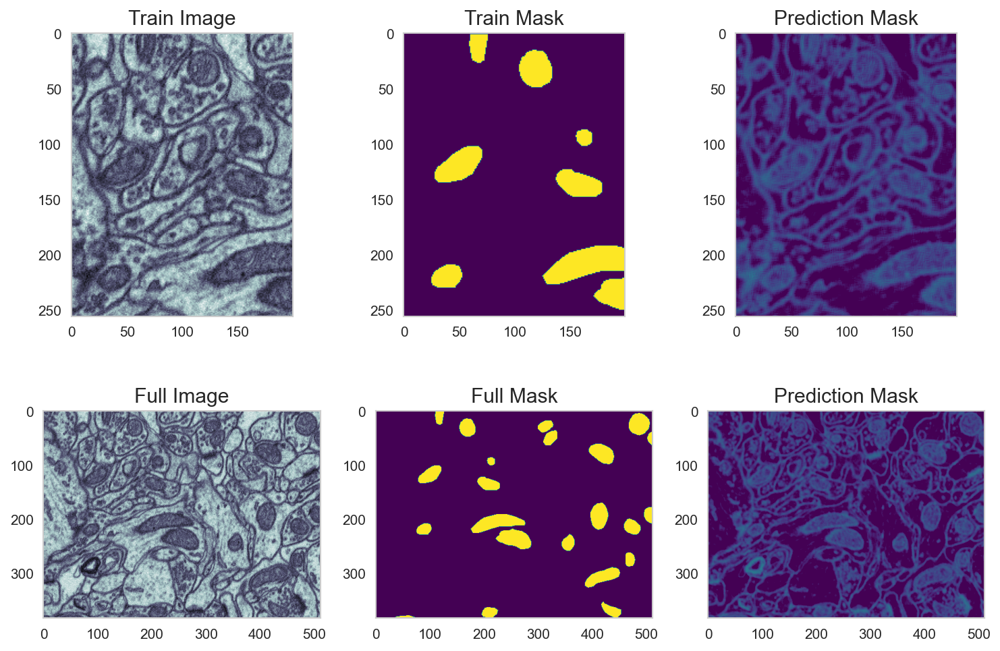

In [105]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots(2, 3, figsize=(12, 8), dpi=150)
ax1.imshow(train_img, cmap='bone') ;ax1.set_title('Train Image')

ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')

ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax2.set_title('Prediction Mask')

ax3.imshow(cell_img, cmap='bone') ; ax3.set_title('Full Image')

ax6.imshow(cell_seg, cmap='viridis') ; ax6.set_title('Full Mask')

ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax4.set_title('Prediction Mask');

### Why Linear Regression?
We choose linear regression so we could get easily understood coefficients. 

The model fits $\vec{m}$ and $b$ to the $\vec{x}_{i,j}$ points in the image $I(i,j)$ to match the $y_{i,j}$ output in the segmentation as closely as possible
$$ y_{i,j} = \vec{m}\cdot\vec{x_{i,j}}+b $$
For a 3x3 cases this looks like
$$ \vec{x}_{i,j} = \left[I(i-1,j-1), I(i-1, j), I(i-1, j+1) \dots I(i+1,j-1), I(i+1, j), I(i+1, j+1)\right] $$

In [107]:
m = linreg_neighborseg_model.steps[-1][1].coef_
b = linreg_neighborseg_model.steps[-1][1].intercept_
print('M: [{:0.4}, {:0.4}, {:0.4}, {:0.4}, \033[1m{:0.4}\033[0m, {:0.4}, {:0.4}, {:0.4}, {:0.4}]'.format(m[0],m[1],m[2],m[3],m[4],m[5],m[6],m[7],m[8]))
print('b: {:0.4}'.format(b))

M: [-0.2957, -0.09922, -0.2537, -0.01986, 0.1371, -0.06423, -0.1706, -0.05163, -0.3065]
b: 0.6852


### Convolution
The steps we have here make up a convolution. 
- What we have effectively done is use linear regression 
- to learn which coefficients we should use in a convolutional kernel to get the best results

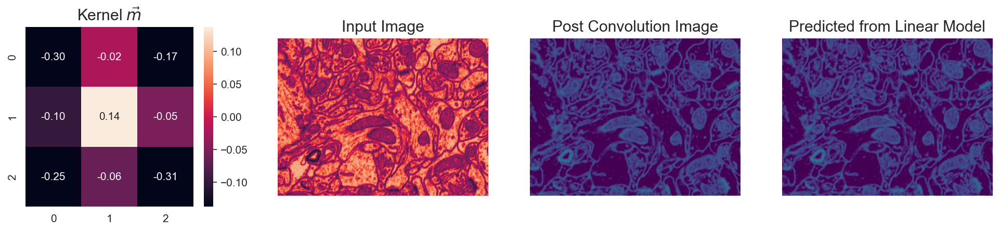

In [108]:
from scipy.ndimage import convolve
m_mat = m.reshape((3, 3)).T
fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(16, 3))
sns.heatmap(m_mat,
            annot=True,
            ax=ax1, fmt='2.2f',
            vmin=-m_mat.std(),
            vmax=m_mat.std())
ax1.set_title(r'Kernel $\vec{m}$')
ax2.imshow(cell_img)
ax2.set_title('Input Image')
ax2.axis('off')

ax3.imshow(convolve(cell_img, m_mat)+b,
           vmin=0,
           vmax=1,
           cmap='viridis')
ax3.set_title('Post Convolution Image')
ax3.axis('off')

ax4.imshow(pred_func(cell_img)[:, :, 0],
           cmap='viridis', vmin=0, vmax=1)
ax4.set_title('Predicted from Linear Model')
ax4.axis('off');

## Nearest Neighbor
We can also use the neighborhood and nearest neighbor, this means for each pixel and its surrounds we find the pixel in the training set that looks most similar

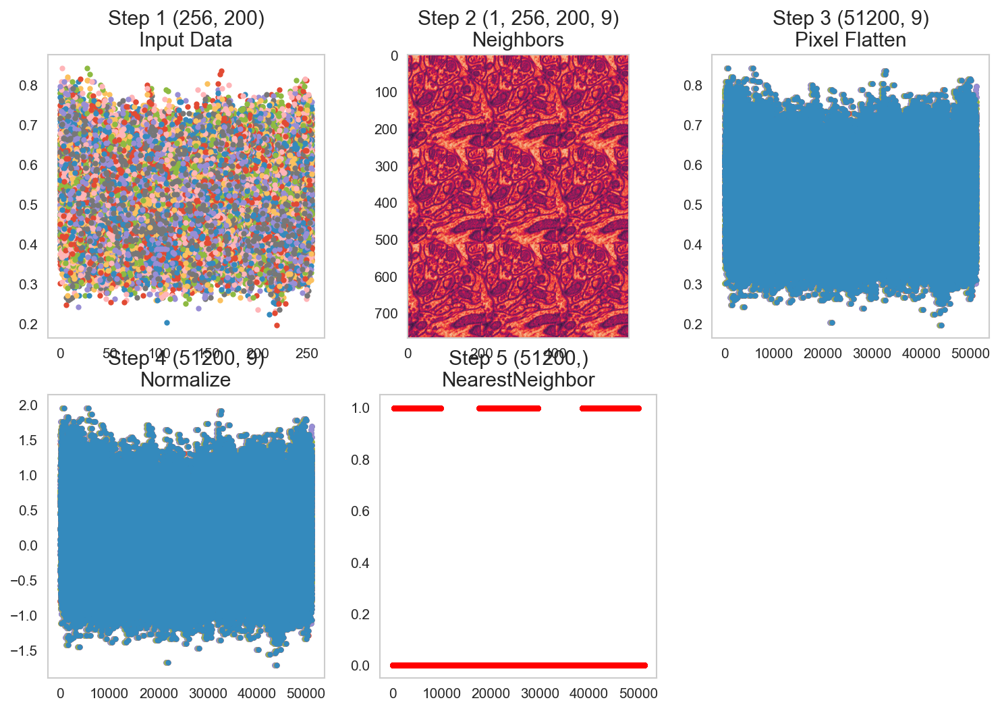

In [109]:
nn_neighborseg_model = Pipeline([('Neighbors', neighbor_step(1, 1)),
                               ('Pixel Flatten', px_flatten_step),
                               ('Normalize', RobustScaler()),
                               ('NearestNeighbor', KNeighborsRegressor(n_neighbors=1))
                               ])

pred_func = fit_img_pipe(nn_neighborseg_model, train_img, train_mask)
show_pipe(nn_neighborseg_model, train_img)

### Results of the nearest neighbor

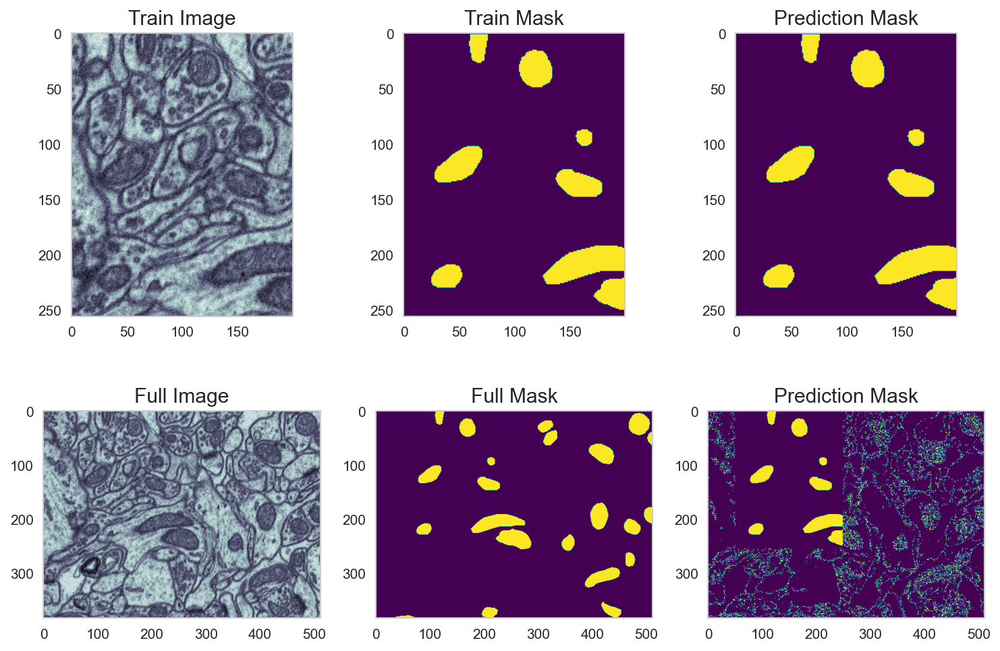

In [110]:
fig, ((ax1, ax5, ax2), (ax3, ax6, ax4)) = plt.subplots(
    2, 3, figsize=(12, 8), dpi=150)
ax1.imshow(train_img, cmap='bone');ax1.set_title('Train Image')

ax5.imshow(train_mask, cmap='viridis'); ax5.set_title('Train Mask')

ax2.imshow(pred_func(train_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1); ax2.set_title('Prediction Mask')

ax3.imshow(cell_img, cmap='bone'); ax3.set_title('Full Image')

ax6.imshow(cell_seg, cmap='viridis'); ax6.set_title('Full Mask')

ax4.imshow(pred_func(cell_img)[:, :, 0], cmap='viridis', vmin=0, vmax=1)
ax4.set_title('Prediction Mask');

## Summarizing the pipeline segmentations 
- We have seen that a pipeline can be efficiently used for segmenation tasks.
    - The pipeline is easy to configure
    - It is easy to read
- Adding generated features can help improving the performance
- None of the method performed convincingly
    - Some failed on validation data
    - Other failed on all data, including training data!

# Deep learning with a U-Net

The last approach we will briefly cover is the idea of [U-Net](https://arxiv.org/abs/1505.04597) a landmark paper from 2015 that dominates MICCAI submissions and contest winners today. A nice overview of the techniques is presented by [Vladimir Iglovikov](https://youtu.be/g6oIQ5MXBE4) a winner of a recent Kaggle competition on masking images of cars [slides](http://slides.com/vladimiriglovikov/kaggle-deep-learning-to-create-a-model-for-binary-segmentation-of-car-images)

<center>
<img src="figures/u-net-architecture.png" style="height:500px" />
</center>

[U-Net Diagram](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png)

### Let's build a small U-Net

In [111]:
import numpy as np
import skimage.io as io
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPool2D, UpSampling2D, concatenate
import tensorflow.keras.losses as losses
from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
base_depth = 32
in_img = Input((None, None, 1), name='Image_Input')
lay_1 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(in_img)
lay_2 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_1)
lay_3 = MaxPool2D((2, 2))(lay_2)
lay_4 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_3)
lay_5 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_4)
lay_6 = MaxPool2D((2, 2))(lay_5)
lay_7 = Conv2D(base_depth*4, kernel_size=(3, 3), padding='same',activation='relu')(lay_6)
lay_8 = Conv2D(base_depth*4, kernel_size=(3, 3), padding='same',activation='relu')(lay_7)
lay_9 = UpSampling2D((2, 2))(lay_8)
lay_10 = concatenate([lay_5, lay_9])
lay_11 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_10)
lay_12 = Conv2D(base_depth*2, kernel_size=(3, 3), padding='same',activation='relu')(lay_11)
lay_13 = UpSampling2D((2, 2))(lay_12)
lay_14 = concatenate([lay_2, lay_13])
lay_15 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_14)
lay_16 = Conv2D(base_depth, kernel_size=(3, 3), padding='same',activation='relu')(lay_15)
lay_17 = Conv2D(1, kernel_size=(1, 1), padding='same',
                activation='sigmoid')(lay_16)
t_unet = Model(inputs=[in_img], outputs=[lay_17], name='SmallUNET')

__A network summary__

In [112]:
t_unet.summary()

Model: "SmallUNET"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Image_Input (InputLayer)       [(None, None, None,  0           []                               
                                 1)]                                                              
                                                                                                  
 conv2d_11 (Conv2D)             (None, None, None,   320         ['Image_Input[0][0]']            
                                32)                                                               
                                                                                                  
 conv2d_12 (Conv2D)             (None, None, None,   9248        ['conv2d_11[0][0]']              
                                32)                                                       

#### A schematic rendering of the network

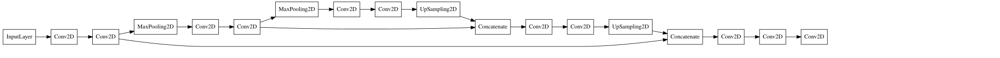

In [124]:
dot_mod = model_to_dot(t_unet, show_shapes=False, show_layer_names=False, dpi=60)
dot_mod.set_rankdir('LR')
SVG(dot_mod.create_svg())

## New training data
We need to reduce the training image (to save time)  

In [125]:
cell_img = ((imread("data/em_image.png")[::2, ::2])/255.0).astype(float)
cell_seg = (imread("data/em_image_seg.png", as_gray=True)[::2, ::2] > 0).astype(float)

train_img, valid_img   = cell_img[:256, 50:250], cell_img[:, 256:]
train_mask, valid_mask = cell_seg[:256, 50:250], cell_seg[:, 256:]

# add channels and sample dimensions
def prep_img(x, n=1): return (
    prep_mask(x, n=n)-train_img.mean())/train_img.std()

def prep_mask(x, n=1): return np.stack([np.expand_dims(x, -1)]*n, 0)

print('Training', train_img.shape, train_mask.shape)
print('Validation Data', valid_img.shape, valid_mask.shape)

Training (256, 200) (256, 200)
Validation Data (384, 256) (384, 256)


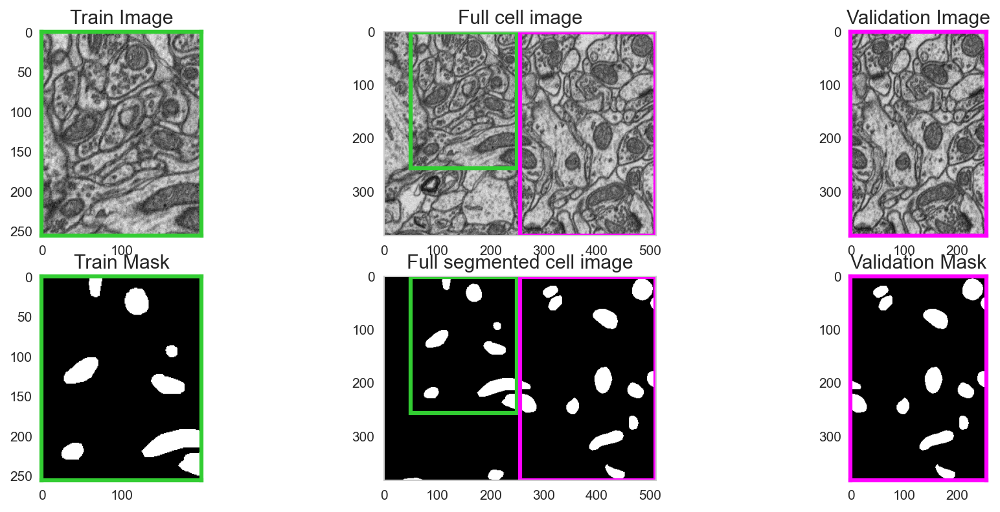

In [81]:
from matplotlib.patches import Rectangle
from matplotlib.spines import Spine



r_train    = Rectangle((50,0),200,256,fc='none',ec='limegreen',lw=3)
r_validate = Rectangle((256,0),cell_img.shape[1]-258,cell_img.shape[0]-1,fc='none',ec='magenta',lw=3)
fig, ax = plt.subplots(2, 3, figsize=(15, 6) )
ax=ax.ravel()
cmap='gray'

def coloraxes(ax,color) :
    for child in ax.get_children():
        if isinstance(child, Spine):
            child.set_color(color)
            child.set_linewidth(3)
        
ax[0].imshow(train_img, cmap=cmap)
ax[0].set_title('Train Image')
coloraxes(ax[0],'limegreen')

ax[3].imshow(train_mask, cmap=cmap)
ax[3].set_title('Train Mask')
coloraxes(ax[3],'limegreen')

ax[1].imshow(cell_img,cmap=cmap)
ax[1].set_title('Full cell image')
ax[1].add_patch(r_train)
ax[1].add_patch(r_validate)

r_train    = Rectangle((50,0),200,256,fc='none',ec='limegreen',lw=3)
r_validate = Rectangle((256,0),cell_img.shape[1]-258,cell_img.shape[0]-1,fc='none',ec='magenta',lw=3)
ax[4].imshow(cell_seg,cmap=cmap)
ax[4].set_title('Full segmented cell image')
ax[4].add_patch(r_train)
ax[4].add_patch(r_validate)

ax[2].imshow(valid_img, cmap=cmap)
ax[2].set_title('Validation Image')
coloraxes(ax[2],'magenta')
ax[5].imshow(valid_mask, cmap=cmap)
ax[5].set_title('Validation Mask');
coloraxes(ax[5],'magenta')

## Results from Untrained Model
- We can make predictions with an untrained model (default parameters)
- but we clearly do not expect them to be very good

In [126]:
unet_pred = t_unet.predict(prep_img(cell_img))[0, :, :, 0];

1/1 [==============================] - 0s 183ms/step


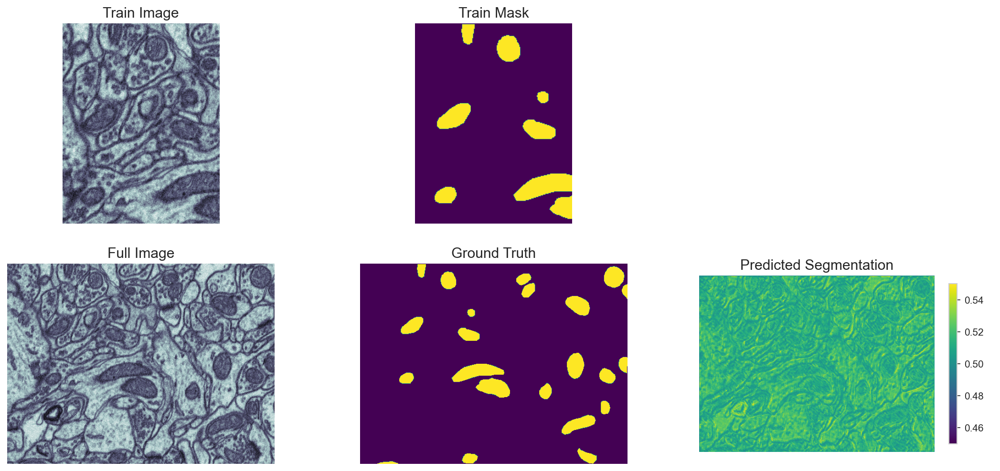

In [137]:
fig, m_axs = plt.subplots(2, 3,
                          figsize=(18, 8), dpi=150)
for c_ax in m_axs.flatten():
    c_ax.axis('off')
((ax1, ax2, _), (ax3, ax4, ax5)) = m_axs
ax1.imshow(train_img, cmap='bone')
ax1.set_title('Train Image')
ax2.imshow(train_mask, cmap='viridis')
ax2.set_title('Train Mask')

ax3.imshow(cell_img, cmap='bone')
ax3.set_title('Full Image')

ax4.imshow(cell_seg,
           cmap='viridis')
ax4.set_title('Ground Truth');

a5=ax5.imshow(unet_pred,
           cmap='viridis', vmin=0.45,vmax=0.55)
ax5.set_title('Predicted Segmentation')
fig.colorbar(a5,ax=ax5,shrink=0.8)

## A general note on the following demo
This is a very bad way to train a model;
- the loss function is poorly chosen, 
- the optimizer can be improved the learning rate can be changed, 
- the training and validation data __should not__ come from the same sample (and __definitely__ not the same measurement). 

The goal is to be aware of these techniques and have a feeling for how they can work for complex problems 

### Training conditions
- [Loss function](https://en.wikipedia.org/wiki/Loss_function) - MAE
- Optimizer - [Stochastic Gradient Decent](https://en.wikipedia.org/wiki/Stochastic_gradient_descent)
- 20 Epochs (training iterations)
- Metrics 
    1. Binary accuracy (percentage of pixels correct classified)
$$BA=\frac{1}{N}\sum_i(f_i==g_i)$$
    2. Mean absolute error
    
Another popular metric is the Dice score
$$DSC=\frac{2|X \cap Y|}{|X|+|Y|}=\frac{2\,TP}{2TP+FP+FN}$$

### Let's train the model

In [138]:
# from keras.optimizers import adam_v2
from keras.optimizers import sgd_experimental

#opt = adam_v2.Adam(learning_rate=0.02)
opt = sgd_experimental.SGD(learning_rate=0.05)

t_unet.compile(
            # we use stochastic gradient descent to optimize
            optimizer='sgd', 
            # we use a simple loss metric of mean-squared error to optimize
            loss=losses.MeanSquaredError(),   
            # we keep track of the number of pixels correctly classified and the mean absolute error as well
            metrics=['binary_accuracy', 'mae'])

loss_history = t_unet.fit(prep_img(train_img, n=5),
                          prep_mask(train_mask, n=5),
                          validation_data=(prep_img(valid_img.astype(float)),
                                           prep_mask(valid_mask.astype(float))),
                          epochs=20,verbose=0)

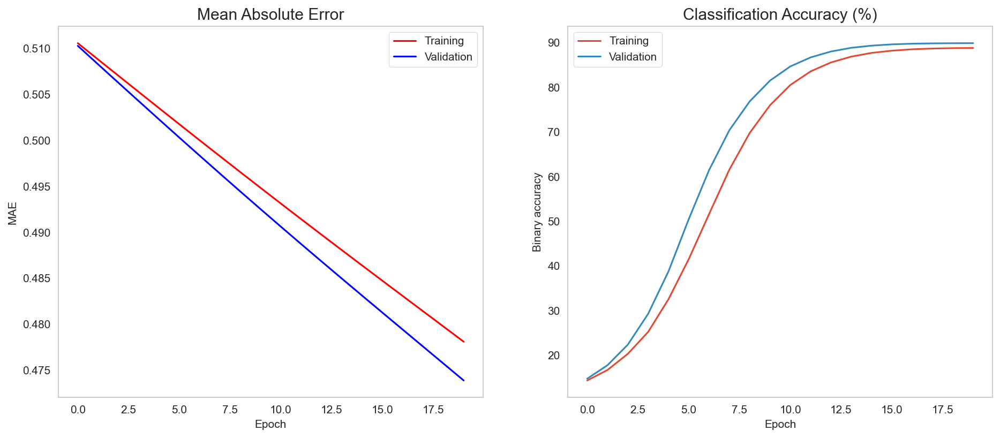

In [143]:
fig, (ax1, ax2) = plt.subplots(1, 2,
                               figsize=(15,6))
ax1.plot(loss_history.epoch,
         loss_history.history['mae'], 'r-', label='Training')
ax1.plot(loss_history.epoch,
         loss_history.history['val_mae'], 'b-', label='Validation')
ax1.set_title('Mean Absolute Error')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('MAE')
ax1.legend()

ax2.plot(loss_history.epoch,
         100*np.array(loss_history.history['binary_accuracy']), '-', label='Training')
ax2.plot(loss_history.epoch,
         100*np.array(loss_history.history['val_binary_accuracy']), '-', label='Validation')

ax2.set_xlabel('Epoch')
ax2.set_ylabel('Binary accuracy')
ax2.set_title('Classification Accuracy (%)')
ax2.legend();

### Prediction results

In [160]:
unet_train = t_unet.predict(prep_img(train_img))[0, :, :, 0]
unet_pred = t_unet.predict(prep_img(cell_img))[0, :, :, 0]

1/1 [==============================] - 0s 131ms/step


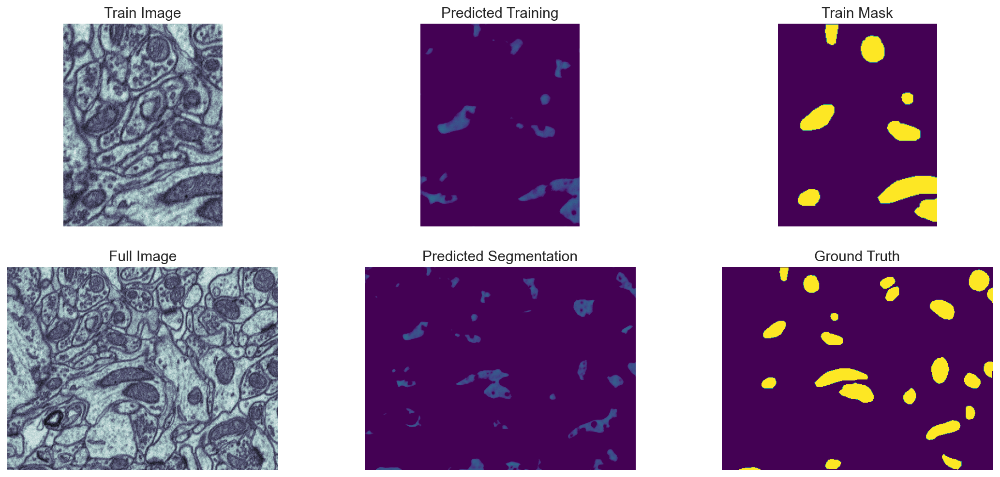

In [161]:
fig, m_axs = plt.subplots(2, 3,
                          figsize=(18, 8), dpi=150)
for c_ax in m_axs.flatten():
    c_ax.axis('off')
((ax1, ax15, ax2), (ax3, ax4, ax5)) = m_axs
ax1.imshow(train_img, cmap='bone')
ax1.set_title('Train Image')
ax15.imshow(unet_train, cmap='viridis', vmin=0.4, vmax=0.6)
ax15.set_title('Predicted Training')
ax2.imshow(train_mask, cmap='viridis')
ax2.set_title('Train Mask')

ax3.imshow(cell_img, cmap='bone')
ax3.set_title('Full Image')

ax4.imshow(unet_pred,
           cmap='viridis', vmin=0.4, vmax=0.6)
ax4.set_title('Predicted Segmentation')

ax5.imshow(cell_seg,
           cmap='viridis')
ax5.set_title('Ground Truth');

## Overfitting

Having a model with 470,000 free parameters means that it is quite easy to overfit the model by training for too long. 

Overfitting is when:
- The model has gotten very good at the training data 
- but hasn't generalized to other kinds of problems 

__Consequence:__ The model starts to perform worse on regions that aren't exactly the same as the training.

In [147]:
t_unet.compile(
    # we use a simple loss metric of mean-squared error to optimize
    loss='mse',
    # we use stochastic gradient descent to optimize
    optimizer=sgd_experimental.SGD(learning_rate=0.5),
    # we keep track of the number of pixels correctly classified and the mean absolute error as well
    metrics=['binary_accuracy', 'mae']
)

loss_history = t_unet.fit(prep_img(train_img),
                          prep_mask(train_mask),
                          validation_data=(prep_img(valid_img),
                                           prep_mask(valid_mask)),
                          epochs=20, verbose=0)

### Loss history

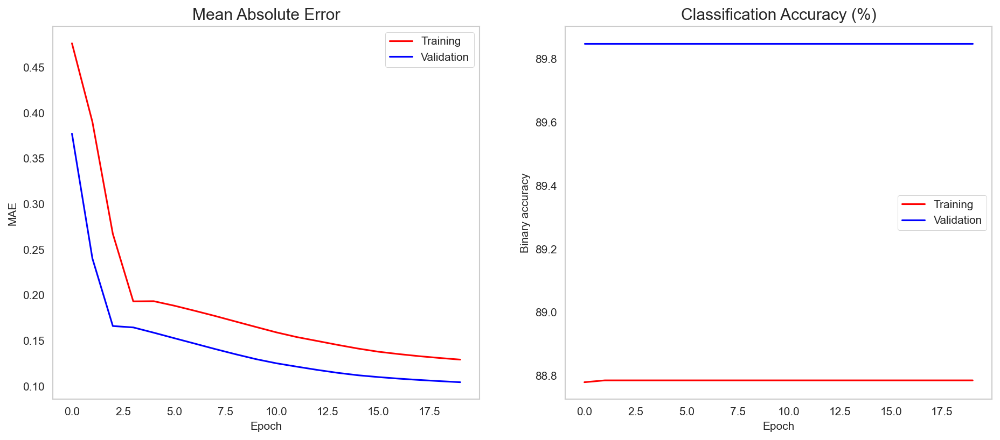

In [156]:
fig, (ax1, ax2) = plt.subplots(1, 2,
                               figsize=(15,6))
ax1.plot(loss_history.epoch,
         loss_history.history['mae'], 'r-', label='Training')
ax1.plot(loss_history.epoch,
         loss_history.history['val_mae'], 'b-', label='Validation')
ax1.set_title('Mean Absolute Error')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('MAE')
ax1.legend()

ax2.plot(loss_history.epoch,
         100*np.array(loss_history.history['binary_accuracy']), 'r-', label='Training')
ax2.plot(loss_history.epoch,
         100*np.array(loss_history.history['val_binary_accuracy']), 'b-', label='Validation')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Binary accuracy')
ax2.set_title('Classification Accuracy (%)')
ax2.legend();

### Prediction results

In [157]:
unet_train = t_unet.predict(prep_img(train_img))[0, :, :, 0]
unet_pred  = t_unet.predict(prep_img(cell_img))[0, :, :, 0]

1/1 [==============================] - 0s 125ms/step


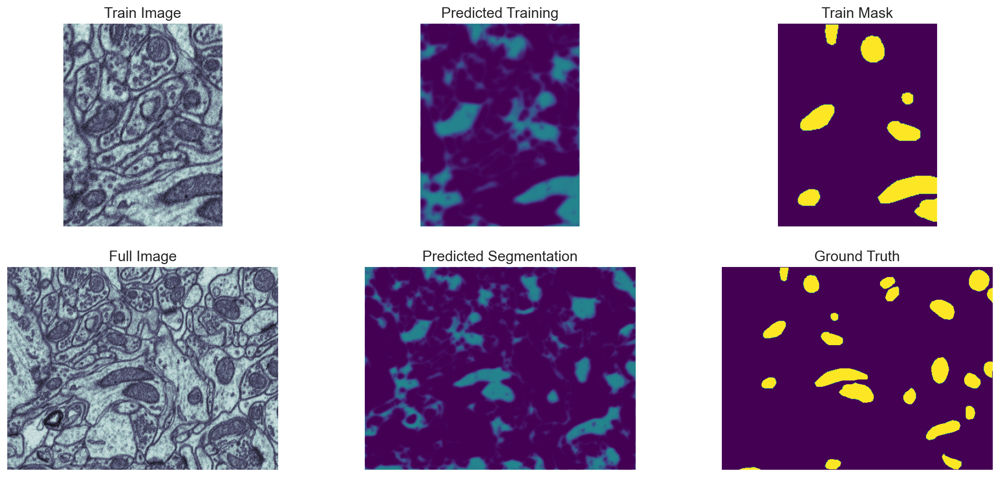

In [158]:
fig, m_axs = plt.subplots(2, 3,
                          figsize=(18, 8), dpi=150)
for c_ax in m_axs.flatten():
    c_ax.axis('off')
((ax1, ax15, ax2), (ax3, ax4, ax5)) = m_axs
ax1.imshow(train_img, cmap='bone')
ax1.set_title('Train Image')
ax15.imshow(unet_train, cmap='viridis', vmin=0, vmax=1)
ax15.set_title('Predicted Training')
ax2.imshow(train_mask, cmap='viridis')
ax2.set_title('Train Mask')

ax3.imshow(cell_img, cmap='bone')
ax3.set_title('Full Image')

ax4.imshow(unet_pred,
           cmap='viridis', vmin=0, vmax=1)
ax4.set_title('Predicted Segmentation')

ax5.imshow(cell_seg,
           cmap='viridis')
ax5.set_title('Ground Truth');

# Summary 
* Concepts of supervised segmentation
* Supervised Classification
* Classification vs. Segmentation
    * Nearest neighbour
    * Trees 
    * Random Forests
* Regression vs Classification
* Training, validation
* Deep learning
